In [1]:
import pandas as pd
import swifter
from plotnine import *
from deepsig import *
import numpy as np
import scipy

from data_beautification import *
from results_utils import meta

from matplotlib import pyplot as plt
params = {'mathtext.default': 'regular' }          
plt.rcParams.update(params)

pd.options.mode.chained_assignment = None  # default='warn'

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


<Figure size 640x480 with 0 Axes>

<a id="0"></a>
# Table of Contents   
1. [Set-up](#setup)
2. [Main paper experiments](#mainxp)
3. [OSR experiment](#osr)
4. [Supplementary](#suppl)
5. [Poster](#poster)

# Set-up <a id="setup"></a>

## Load results CSV

In [2]:
RESULTS_PATH = "./result_csvs"

In [3]:
RESULTS_PATH_CSV = f"{RESULTS_PATH}/noisy_openood_results_xp.csv"
df = pd.read_csv(RESULTS_PATH_CSV)

print(f'Unique training datasets:', df["training_dataset"].unique())

df["noise_type"] = df["training_dataset"].apply(group_noise)
df["noisy_or_not"] = df["noise_type"].apply(noisy_or_not)
df["iid_dataset"] = df["iid_dataset"].apply(rename_iid_ds)

df["ds_group"] = df["training_dataset"].apply(get_dataset_group)
df = df[df["method"].isin(nice_method_names.keys())]
df["method_nice"] = df["method"].apply(lambda x: nice_method_names[x])
df["method_fmt"] = df["method_nice"].apply(lambda x: x.split("-")[0])
df["arch_nice"] = df["arch"].apply(lambda x: nice_archs[x])
df["training_dataset_nice"] = df["training_dataset"].apply(lambda x: meta[x]["nice_name"])
df["iid_dataset_nice"] = df["iid_dataset"].apply(lambda x: nice_dataset_groups[x])
df["clean_version"] = df["training_dataset"].apply(lambda x: get_clean_ds(x))

print(f'Unique dataset groups:', df["ds_group"].unique())

params = ['method','method_nice','method_fmt',
          'training_dataset','training_dataset_nice',
          'ds_group',"noisy_or_not",
          'iid_dataset','iid_dataset_nice',
          'checkpoint',
          'arch',"arch_nice",
          'seed',
          'noise_type',
          'noise_rate',
         'num_classes']
index_params = ['method',
          'training_dataset',
          'checkpoint',
          'arch',
          'seed',
          'ood_dataset']
metrics_of_interest = ["accuracy","failure_auroc","auroc","incorrect_ood_auroc","correct_ood_auroc"]
group_cols = ['ood_dataset','ood_group']
print(f'Unique OOD detectors',df["method"].unique())

df = df.drop_duplicates()

len_dict = dict()

df = df.set_index(index_params)
df_idx = df.sort_index()
df = df.reset_index()

df_clean_idx = df_idx[df_idx["noise_type"].isin(["clean"])]

the_20_methods = ['knn-train', 'klm-train', 'ash_s','react_mod-train'
 ,'odin_mod','msp','mls',
 'mds-train','mds_ensemble_mod2-train', 'rankfeat',
 'dice_mod-train', 'gram_mod-train', 'vim',
 'rmds-train', 'she-train', 'temp_scaling-val',
 'gradnorm', 'openmax-train', 'gen', 'ebo']
assert len(the_20_methods) == 20, len(the_20_methods)

aggregate_ood_dataset_func = lambda df: df.median()

df_osr = df[df["ds_group"].isin(["fgvc-aircraft","fgvc-cub"])]
df_ood = df[~df["ds_group"].isin(["fgvc-aircraft","fgvc-cub"])]

print(f'Unique ID datasets in df_osr', df_osr["iid_dataset_nice"].unique())
print(f'Unique ID datasets in df_ood', df_ood["iid_dataset_nice"].unique())

Unique training datasets: ['fgvc-aircraft_clean' 'fgvc-aircraft_symm0.1' 'fgvc-aircraft_symm0.2'
 'fgvc-cub_clean' 'fgvc-cub_symm0.1' 'fgvc-cub_symm0.2' 'cifar10'
 'cifar10_noisy_agg' 'cifar10_noisy_random1' 'cifar10_noisy_worse'
 'cifar10_symm_agg' 'cifar10_symm_random1' 'cifar10_symm_worse'
 'cifar10_asymm_agg' 'cifar10_asymm_random1' 'cifar10_asymm_worse'
 'cifar100' 'cifar100_noisy_fine' 'cifar100_clean_coarse'
 'cifar100_noisy_coarse' 'cifar100_symm_fine' 'cifar100_asymm_fine'
 'cifar100_symm_coarse' 'cifar100_asymm_coarse' 'clothing1M_clean'
 'clothing1M_cleanval_symm' 'clothing1M_cleanval_asymm'
 'clothing1M_cleanval']
Unique dataset groups: ['fgvc-aircraft' 'fgvc-cub' 'cifar10' 'cifar10-agg' 'cifar10-random1'
 'cifar10-worse' 'cifar100' 'cifar100-fine' 'cifar100-coarse' 'clothing1M']
Unique OOD detectors ['knn-train' 'klm-train' 'ash_s' 'react_mod-train' 'msp' 'mls' 'mds-train'
 'mds_ensemble_mod2-train' 'rankfeat' 'dice_mod-train' 'gram_mod-train'
 'vim' 'rmds-train' 'she-trai

## Common theme stuff

In [4]:
import matplotlib.font_manager as fm
roboto_light = fm.FontProperties(fname='./fonts/Roboto-Light.ttf')
roboto_reg = fm.FontProperties(fname='./fonts/Roboto-Regular.ttf')

common_theme = theme(figure_size=(12, 9),
        #legend_direction='horizontal',
        legend_position='top',
        legend_title = element_text(size=20, ha="center"),
        legend_text_colorbar = element_text(size=12, va="bottom"),
    )
common_hline = geom_hline(yintercept = 0.5,
                  color='red',    # set line colour
                  size=1,            # set line thickness
                  linetype="dashed"  # set line type
                 )
common_smooth = stat_smooth(method="loess", color="grey")


rotate_x_labels = theme(axis_text_x=element_text(rotation=90, hjust="center"))

theme_text_sizes = theme(axis_text_x=element_text(size=13),
                         axis_text_y=element_text(size=13),
                         axis_title_x = element_text(size=13),
                         axis_title_y = element_text(size=13),
                         strip_text=element_text(size=14),
                         legend_text=element_text(size=12),
                         plot_margin=0.01,
                        )
theme_font = theme(text=element_text(fontproperties=roboto_reg))

class theme_bw2(theme_gray):
    """
    White background with black gridlines

    Parameters
    ----------
    base_size : int
        Base font size. All text sizes are a scaled versions of
        the base font size.
    base_family : str
        Base font family. If `None`, use [](`plotnine.options.base_family`).
    """

    def __init__(self, base_size=11, base_family=None):
        super().__init__(base_size, base_family)
        self += theme(
            #axis_text=element_text(size=0.8 * base_size),
            text=element_text(fontproperties=roboto_reg),
            legend_key=element_rect(fill="none", color="#CCCCCC"),
            panel_background=element_rect(fill="white"),
            panel_border=element_rect(fill="none", color="#7f7f7f"),
            panel_grid_major=element_line(color="#E5E5E5"),
            panel_grid_minor=element_line(color="#FAFAFA"),
            strip_background=element_rect(
                fill="#CCCCCC", color="#7F7F7F", size=1
            ),
            strip_text_x=element_text(color="black"),
            strip_text_y=element_text(color="black", angle=-90),
        )

## Aggregating results

In [5]:
df_avg_ood = aggregate_ood_dataset_func(df_ood.groupby(params)[metrics_of_interest]).reset_index()
df_avg_ood["noise_type"] = pd.Categorical(df_avg_ood["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)

df_avg_ood_20 = df_avg_ood.loc[df_avg_ood["method"].isin(the_20_methods)]

print(df_avg_ood_20["iid_dataset_nice"].unique())

df_avg_ood_all = aggregate_ood_dataset_func(df.groupby(params)[metrics_of_interest]).reset_index()
df_avg_ood_all["noise_type"] = pd.Categorical(df_avg_ood_all["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)


df_avg_ood_20_all = df_avg_ood_all.loc[df_avg_ood_all["method"].isin(the_20_methods)]

print(df_avg_ood_20_all["iid_dataset_nice"].unique())

['CIFAR-10' 'CIFAR-100-Fine' 'CIFAR-100-Coarse' 'Clothing1M']
['CIFAR-10' 'CIFAR-100-Fine' 'CIFAR-100-Coarse' 'Clothing1M'
 'FGVC-Aircraft' 'CUB']


In [6]:
def get_clean_auroc(d):
    clean_res = df_clean_idx["auroc"].loc[d["method"],d["clean_version"],d["checkpoint"],d["arch"],d["seed"],d["ood_dataset"]]
    return clean_res

def get_clean_acc(d):
    clean_res = df_clean_idx["accuracy"].loc[d["method"],d["clean_version"],d["checkpoint"],d["arch"],d["seed"],d["ood_dataset"]]
    return clean_res

ood_metrics = ["accuracy","auroc"]
df_ood["accuracy_clean"] = df_ood.swifter.progress_bar(True).apply(get_clean_acc, axis=1)
df_ood["auroc_clean"] = df_ood.swifter.progress_bar(True).apply(get_clean_auroc, axis=1)

df_noisy = df_ood.loc[~df_ood["noise_type"].isin(["clean"]) & df_ood["method"].isin(the_20_methods)]
df_clean = df_ood.loc[df_ood["noise_type"].isin(["clean"]) & df_ood["method"].isin(the_20_methods)]

for metric in ood_metrics:
    df_noisy[f"{metric}_gap"] = df_noisy[f"{metric}_clean"] - df_noisy[f"{metric}"]
    df_noisy[f"{metric}_gap_abs"] = np.abs(df_noisy[f"{metric}_clean"] - df_noisy[f"{metric}"])
    df_noisy[f"{metric}_gap_clip"] = np.clip(df_noisy[f"{metric}_clean"] - df_noisy[f"{metric}"],0,None)

gap_metrics = ["accuracy_clean","auroc_clean"]
dfs_avg_dict = dict()
for metric in ood_metrics:
    lst = [f"{metric}",f"{metric}_gap",f"{metric}_gap_abs",f"{metric}_gap_clip"]
    gap_metrics.extend(lst)
    
df_noisy_avg_ood = aggregate_ood_dataset_func(df_noisy.groupby(params)[gap_metrics]).reset_index()
df_clean_avg_ood = aggregate_ood_dataset_func(df_clean.groupby(params)[ood_metrics+["accuracy"]]).reset_index()
df_noisy_avg_ood["iid_dataset_nice"] = pd.Categorical(df_noisy_avg_ood["iid_dataset_nice"], categories = [v for v in nice_dataset_groups.values() if v in df_noisy_avg_ood["iid_dataset_nice"].unique()], ordered=True)
df_noisy_avg_ood["noise_type"] = pd.Categorical(df_noisy_avg_ood["noise_type"], categories = ["real","asymm","symm"], ordered=True)

#print(df_noisy_avg_ood.reset_index().columns)

df_noisy_avg_ood["checkpoint_fmt"] = df_noisy_avg_ood["checkpoint"].apply(lambda x: "last" if "last" in x else "early")
df_noisy_avg_ood["method_fmt"] = df_noisy_avg_ood["method_nice"].apply(lambda x: x.split("-")[0])

print(df_noisy_avg_ood["iid_dataset_nice"].unique())

Pandas Apply: 100%|████████████████████| 83160/83160 [00:04<00:00, 18728.23it/s]


['CIFAR-100-Coarse', 'CIFAR-100-Fine', 'CIFAR-10', 'Clothing1M']
Categories (4, object): ['CIFAR-10' < 'CIFAR-100-Coarse' < 'CIFAR-100-Fine' < 'Clothing1M']


# Main paper experiments <a id="mainxp"></a>

## Figure 1

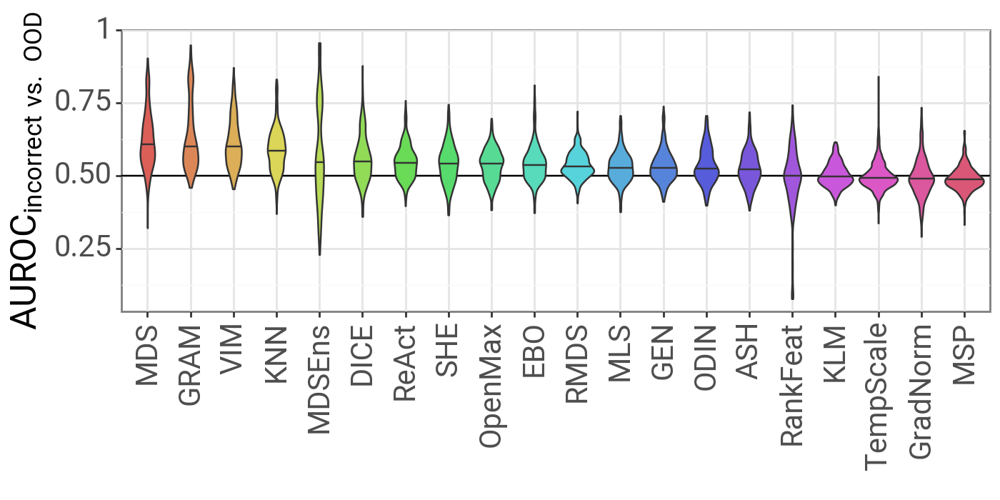

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 7 x 3.5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/incorrect_auroc_ranking_emb.pdf


In [7]:
assert len(df_avg_ood_20)/20 == 396

incorrect_median = df_avg_ood_20.groupby("method_nice")["incorrect_ood_auroc"].median().sort_values().index

df_avg_ood_20["method_nice_sorted"] = pd.Categorical(df_avg_ood_20["method_nice"], categories=incorrect_median[::-1], ordered=True)
df_avg_ood_20["method_fmt"] = df_avg_ood_20["method_nice_sorted"].apply(lambda x: x.split("-")[0])

plt = (ggplot(df_avg_ood_20, aes(x="method_fmt", y="incorrect_ood_auroc", fill="method_fmt"))
       + geom_hline(yintercept=0.5)
       + geom_violin(draw_quantiles=0.5, na_rm=False)
       + scale_fill_discrete(guide=False)
       + scale_y_continuous(name="$\mathregular{AUROC_{incorrect~vs.~OOD}}$")
       + scale_x_discrete(name="")
       + theme_bw2()
       + theme_text_sizes
       + theme(
         axis_text_x=element_text(rotation=90,hjust=0.5,size=15),
         axis_text_y=element_text(size=15),
         axis_title_y=element_text(size=18),
         figure_size=(7, 3.5)
        )
      )
print(plt)
plt.save("paper_plots/incorrect_auroc_ranking_emb.pdf")

## Figure 2

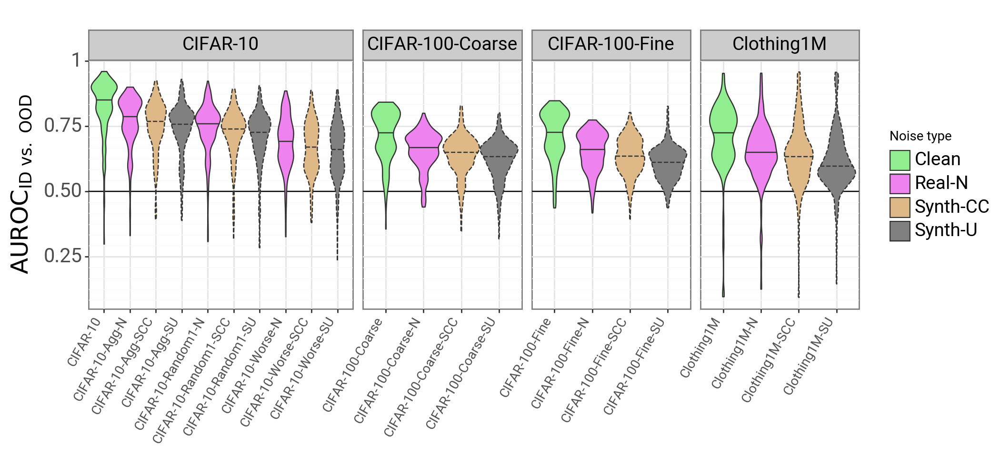

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10.5 x 5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/auroc-noisy-per-dataset-violin_emb.pdf


In [8]:
ood_metric = "auroc"

dodge_text = position_dodge(width=0.9) 
df_avg_ood_20["width"] = df_avg_ood_20["training_dataset"].apply(lambda x: 1)
df_avg_ood_20["linetype"] = df_avg_ood_20["noise_type"].apply(lambda x: "dotted" if not "symm" in x else "solid")

plt = (ggplot(df_avg_ood_20, aes(x="training_dataset_nice", y=f"{ood_metric}", fill="noise_type", width="width", linetype="linetype"))
 + geom_hline(yintercept=0.5)
 + geom_violin(draw_quantiles=0.5)
 + facet_grid("~iid_dataset_nice", scales="free_x", space={'x': [2, 1.2, 1.2, 1.2]})
 + scale_y_continuous(name="$\mathrm{AUROC_{ID~vs.~OOD}}$", minor_breaks=5)
 + scale_x_discrete(name="")
 + scale_fill_manual(name="Noise type", labels=["Clean","Real-N","Synth-CC","Synth-U"], values = {"clean": "lightgreen", "real": "violet", "asymm": "burlywood", "symm": "gray"})
 + scale_linetype_discrete(guide=False)
 + theme_bw2()
+ theme(figure_size=(10.5,5), axis_text_x=element_text(rotation=60, hjust=1),
        strip_text=element_text(size=14),
        axis_text_y=element_text(size=15),
        axis_title_y=element_text(size=18),
       legend_text=element_text(size=14))

)
print(plt)
plt.save(f"paper_plots/{ood_metric}-noisy-per-dataset-violin_emb.pdf")

## Figure 3

In [9]:
import scipy
corr_metric = "accuracy"
measure_metric = "auroc"

corr_dict = {
    "Spearman": scipy.stats.spearmanr,
}

split_param = "noise_type"

summary_dicts = list()
for corr_type, corr_func in corr_dict.items(): 

    print(corr_type)
    print(df_ood["method"].unique())
    for method in df_ood["method"].unique():
        if method not in the_20_methods: continue
        
        for param_option in df_ood[split_param].unique():

            df_method = df_ood[df_ood["method"]==method]
            df_method = df_method[df_method[split_param]==param_option]
        
            corr, p = corr_func(df_method[f"{corr_metric}"], df_method[measure_metric])
        
            summary_dicts.append({
                        "method": nice_method_names[method].replace("-mod","").replace("-val","").replace("2",""),
                        "corr": corr,
                        "p": p,
                        "corr_type": corr_type,
                        split_param: param_option
                    })
    df_summary = pd.DataFrame(summary_dicts)
    df_summary = df_summary.sort_values(by=['corr'],ascending=True)
    if split_param == "noise_type":
        df_summary["noise_type"] = pd.Categorical(df_summary["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)

    print(df_summary["p"].max())
     

Spearman
['knn-train' 'klm-train' 'ash' 'ash_s' 'react_mod-train' 'odin_mod'
 'odin_nopert' 'odin_notemp' 'msp' 'mls' 'mds-val' 'mds-train'
 'mds_ensemble_mod2-train' 'mds_ensemble_mod2-val' 'rankfeat'
 'dice_mod-train' 'gram_mod-val' 'gram_mod-train' 'vim' 'rmds-val'
 'rmds-train' 'she-val' 'she-train' 'temp_scaling-val'
 'temp_scaling-train' 'gradnorm' 'openmax-val' 'openmax-train' 'gen' 'ebo']
0.0007652146986820367


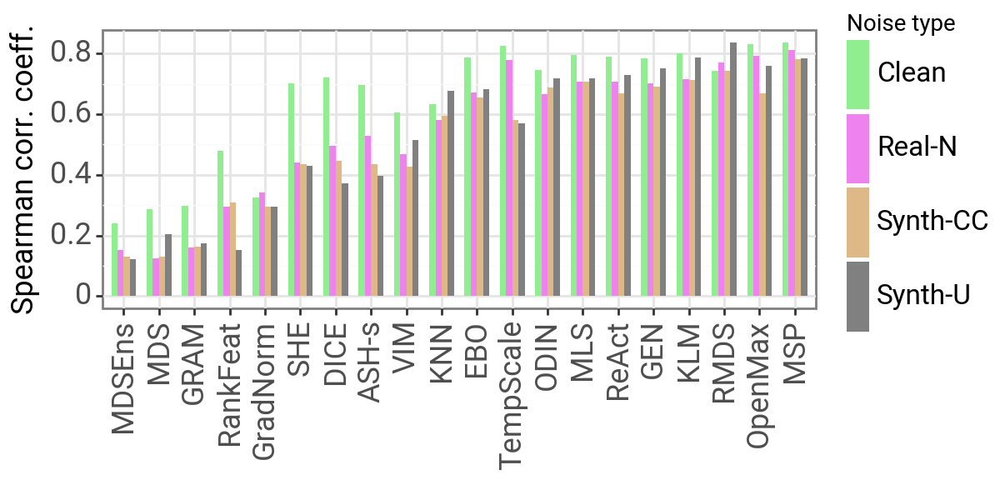

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 3 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/accuracy_auroc_corr_per_noise_type.pdf


In [10]:
scales = {
    "noise_type": scale_fill_manual(name="Noise type",
                                    labels=["Clean","Real-N","Synth-CC","Synth-U"],
                                    values = {"clean": "lightgreen", "real": "violet", "asymm": "burlywood", "symm": "gray"}),
    "checkpoint": scale_fill_discrete(name="checkpoint")
}

plt = (ggplot(df_summary, aes("reorder(method,corr)", "corr", fill=split_param))
 + geom_col(stat='identity', position='dodge', width=0.7)
 + theme_bw2()
 + theme(
    legend_key_width=10,
    legend_key_height=30
   )
 + theme(figure_size=(6,3))
 
 + scale_y_continuous(name="Spearman corr. coeff.")
 + scale_x_discrete(name="")
 + theme(axis_text_x=element_text(rotation=90, ha="center"))
 + scales[split_param]
 + theme_text_sizes
)
print(plt)
plt.save(f"paper_plots/{corr_metric}_{measure_metric}_corr_per_{split_param}.pdf")

## Figure 4

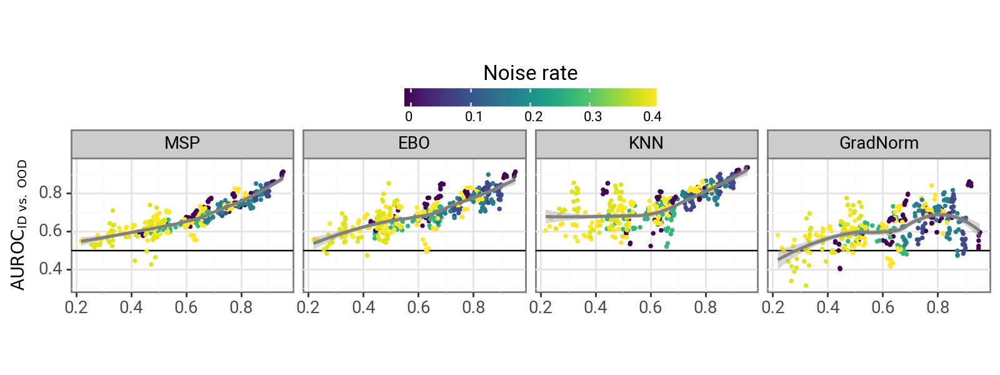

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 3 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/accuracy-vs-auroc-arch-selected_emb.pdf


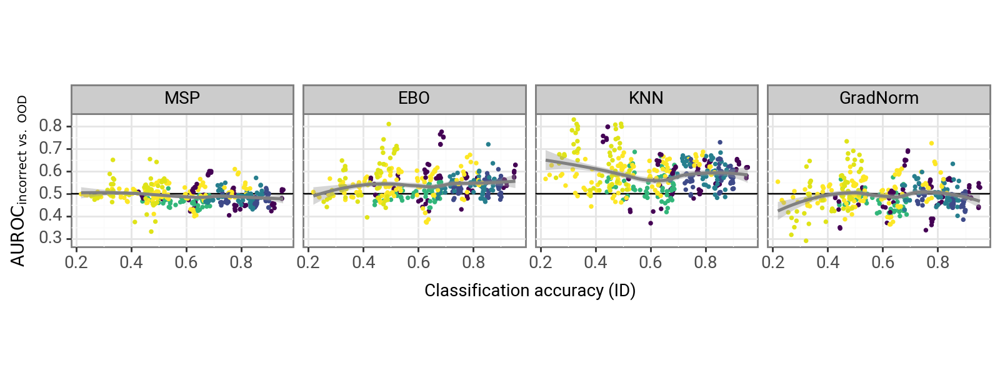

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 3 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/accuracy-vs-incorrectauroc-arch-selected_emb.pdf


In [11]:
## Figure 4
common_y_axis = scale_y_continuous(
        name='AUROC (ID vs. OOD)', limits=(df_avg_ood["auroc"].min(), 1)
    )
common_x_axis = scale_x_continuous(
        name='Classification accuracy (ID)'
    )


df_avg_ood_selected = df_avg_ood[df_avg_ood["method"].isin(["msp", "ebo","gradnorm", "knn-train"])]
df_avg_ood_selected["method_fmt"] = df_avg_ood_selected["method_nice"].apply(lambda x: x.replace("-mod",""))
df_avg_ood_selected["method_fmt"] = pd.Categorical(df_avg_ood_selected["method_fmt"], categories=["MSP","EBO","KNN","GradNorm"])

plt = (ggplot(df_avg_ood_selected, aes("accuracy", "auroc", color="noise_rate"))
 + geom_hline(yintercept=0.5)
 + geom_point(size=0.5)
 + stat_smooth(method="loess", color="grey")
 + facet_wrap("~method_fmt", ncol=4)
 + scale_y_continuous(name="$\mathrm{AUROC_{ID~vs.~OOD}}$")
 + scale_color_continuous(name="Noise rate")
 + scale_x_continuous(name="")
 + scale_alpha_continuous(guide=False)
 + theme_bw2()
 + common_theme
 + theme(
     legend_key_width=7,
     legend_key_height=20,
     legend_box_spacing=0.005,
     figure_size=(8,3),
     aspect_ratio=0.6,
        legend_position='top',
        legend_title_align='center',
        legend_title = element_text(size=12),
        legend_text_colorbar = element_text(size=8, va="bottom"),
    )
)
print(plt)
plt.save("paper_plots/accuracy-vs-auroc-arch-selected_emb.pdf")

plt = (ggplot(df_avg_ood_selected, aes("accuracy", "incorrect_ood_auroc", color="noise_rate"))
 + geom_hline(yintercept=0.5)
 + geom_point(size=0.5)
 + stat_smooth(method="loess", color="grey")
 + facet_wrap("~method_fmt", ncol=4)
 + scale_y_continuous(name="$\mathrm{AUROC_{incorrect~vs.~OOD}}$")
 + scale_color_continuous(guide=False)
 + common_x_axis
 + scale_alpha_continuous(guide=False)
 + theme_bw2()
 + common_theme
 + theme(
     legend_key_width=10,
     legend_key_height=30,
     legend_box_spacing=0,
     figure_size=(8,3),
     aspect_ratio=0.6
    )
)
print(plt)
plt.save("paper_plots/accuracy-vs-incorrectauroc-arch-selected_emb.pdf")


## Figure 5

mls


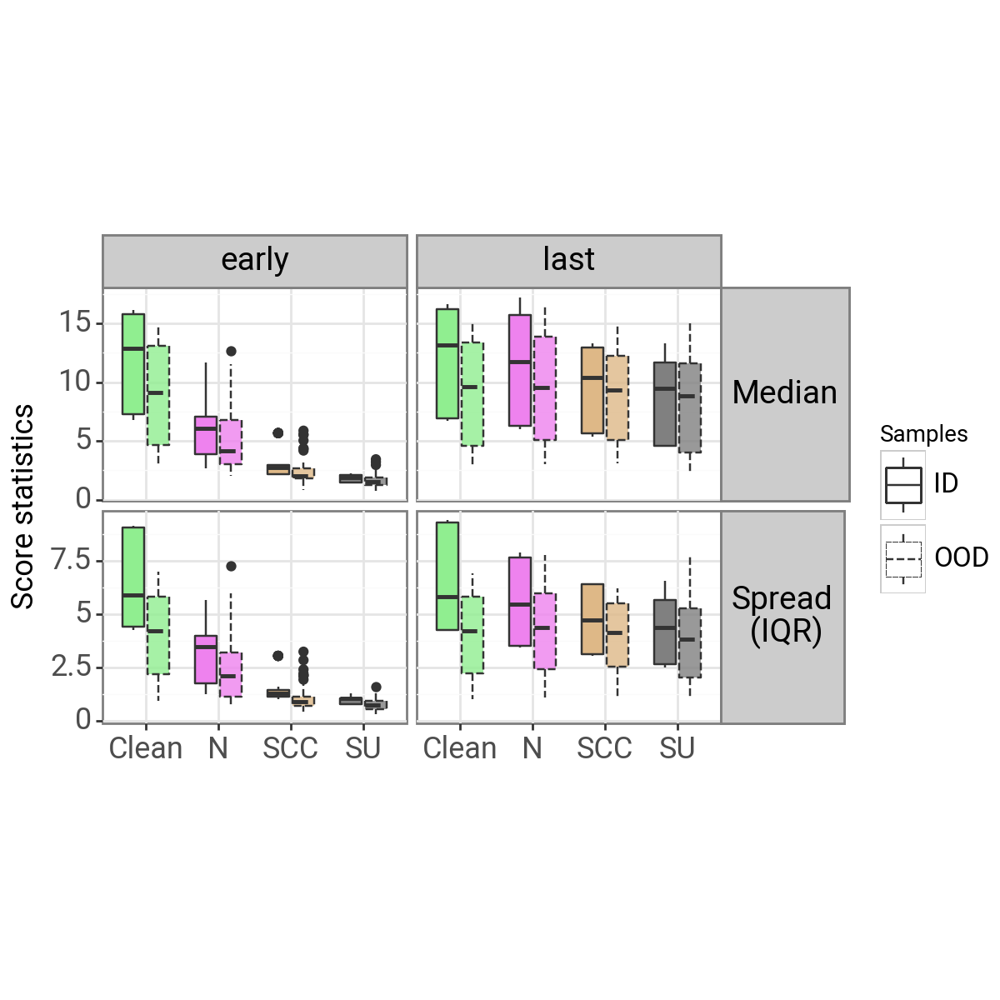

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 6 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/mls-score-stats-per-noise_type_emb.pdf


In [12]:
split_by = "noise_type"

if split_by == "id_ood_split":
    line_id=dict(color='rgba(0,0,255,0.8)')
    line_ood=dict(color='rgba(255,0,0,0.8)')
elif split_by == "checkpoint":
    line_id=dict(color='rgba(0,200,10,0.8)') # best
    line_ood=dict(color='rgba(255,215,0,0.8)') # last
fillcolor='rgba(200, 200, 200, 0.5)'

complicated_plot = False

for method in list(nice_method_names.keys()):

    if method not in ["mls"]: continue
        
    print(method)
    df_scores = pd.read_csv(f"{RESULTS_PATH}/scores-stats_{method}.csv")
    
    df_scores["noise_type"] = df_scores["dataset"].apply(group_noise)
    df_scores["dataset_group"] = df_scores["dataset"].apply(get_dataset_group)
    df_scores["noise_type"] = pd.Categorical(df_scores["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)
    df_scores["id_dataset"] = df_scores["dataset"].apply(rename_iid_ds)
    df_scores["id_dataset_nice"] = df_scores["id_dataset"].apply(lambda x: nice_dataset_groups[x])
    df_scores["checkpoint_nice"] = df_scores["checkpoint"].apply(lambda x: "early" if "best" in x else "last")

    if split_by == "checkpoint":
        melt_id_vars = ["id_dataset_nice","dataset_group","noise_rate","checkpoint"]
        groupby = ["id_dataset_nice","noise_rate","checkpoint",'scores_agg']
    elif split_by == "id_ood_split":
        melt_id_vars = ["id_dataset_nice","dataset_group","noise_rate"]
        groupby = ["id_dataset_nice","dataset_group","noise_rate","id_ood_split",'scores_agg']
    elif split_by == "noise_type":
        melt_id_vars = ["id_dataset_nice","dataset_group","checkpoint","noise_rate","noise_type"]
        groupby = ["id_dataset_nice","dataset_group","checkpoint","noise_rate","noise_type",'scores_agg']

    df_scores = df_scores.rename(columns={'id_median': 'scores_id_median', 'ood_median': 'scores_ood_median', 'id_iqr': 'scores_id_iqr', 'ood_iqr': 'scores_ood_iqr'})
    df_scores = df_scores.drop(['scores_min','scores_max'],axis=1)
    df_scores_melted = pd.wide_to_long(df_scores, ["scores_"], i=["Unnamed: 0"], j="scores_split", suffix="\D+").reset_index()

    df_scores_melted[['id_ood_split', 'scores_agg']] = df_scores_melted['scores_split'].str.split('_', n=1, expand=True)

    df_scores_melted['scores_agg'] =  df_scores_melted['scores_agg'].apply(lambda x: "Spread\n (IQR)" if "iqr" in x else "Median")
    nice_noise_names = {"clean": "Clean", "real": "N", "asymm": "SCC", "symm": "SU"}
    df_scores_melted['noise_type_nice'] = df_scores_melted['noise_type'].apply(lambda x: nice_noise_names[x])
    df_scores_melted['id_ood_split_nice'] = df_scores_melted['id_ood_split'].apply(lambda x: "ID" if "id" in x else "OOD")

    plt = (
        ggplot(df_scores_melted[df_scores_melted["id_dataset_nice"] == "Clothing1M"], aes(x='noise_type_nice', y='scores_',fill=split_by, linetype="id_ood_split_nice", alpha="id_ood_split_nice"))
        + geom_boxplot(width=0.6, position=position_dodge(width = 0.7))
        + facet_grid("scores_agg~checkpoint_nice", scales="free")
        + scale_alpha_manual(values=[1,0.8], guide=False)
        + scale_linetype_discrete(name="Samples")
        + scale_fill_manual(guide=False, labels=["Clean","N","SCC","SU"], values = {"clean": "lightgreen", "real": "violet", "asymm": "burlywood", "symm": "gray"})
        + scale_x_discrete(name="")
        + scale_y_continuous(name="Score statistics")
        + theme_bw2()
        
        + theme_text_sizes
        + theme(
            legend_key_width=20,
            legend_key_height=30
           )
        + theme(figure_size=(6,6), aspect_ratio=0.7, strip_text_y=element_text(rotation=0),
               )
    )
    print(plt)
    plt.save(f"paper_plots/{method}-score-stats-per-{split_by}_emb.pdf")


## Figure 6

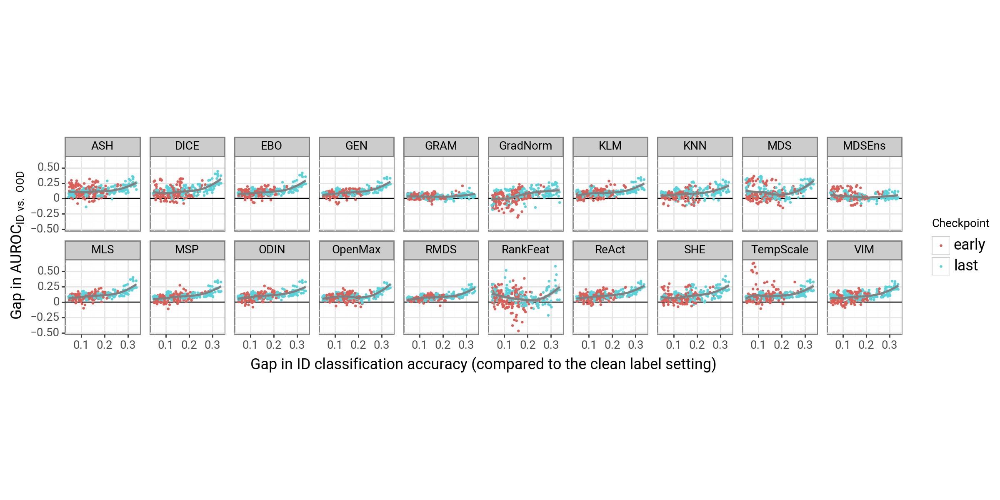

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 6 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: auroc_gap-vs-accuracy_gap_per_checkpoint_emb.pdf


In [13]:
plt = (ggplot(df_noisy_avg_ood, aes(x="accuracy_gap", y="auroc_gap", color="checkpoint_fmt"))
 + geom_hline(yintercept = 0)
 + geom_point(size=0.3)
 + geom_smooth(color="grey", method="loess")
 + scale_color_discrete(name="Checkpoint")
 + scale_x_continuous(name="Gap in ID classification accuracy (compared to the clean label setting)")
 + scale_y_continuous(name="Gap in $\mathregular{AUROC_{ID~vs.~OOD}}$")
 + facet_wrap("method_fmt",ncol=10)
 + theme_bw2()
 + theme(figure_size=(12,6), aspect_ratio=1, legend_text=element_text(size=13),
         axis_title_x=element_text(size=13, margin={"t":5}),
         axis_title_y=element_text(size=13, margin={"r":2}))
)
print(plt)
plt.save(f"auroc_gap-vs-accuracy_gap_per_checkpoint_emb.pdf")

## Table 2

In [14]:
df_avg_ood_best = df_avg_ood.groupby(["training_dataset_nice","method","method_nice"])["auroc"].max().reset_index()

df_avg_ood_best = df_avg_ood_best[df_avg_ood_best["method"].isin(the_20_methods)]
df_avg_ood_best["method_fmt"] = df_avg_ood_best["method_nice"].apply(lambda x: x.split("-")[0])
df_avg_ood_best["auroc_fmt"] = df_avg_ood_best["auroc"].apply(lambda x: x*100)
df_avg_ood_best_pivot = df_avg_ood_best.pivot_table('auroc_fmt', ['method_fmt'], 'training_dataset_nice')
print(df_avg_ood_best_pivot.head().to_markdown())

df_avg_ood_best_pivot.round(2).to_csv(f"paper_csvs/best_auroc_per_method_per_ds.csv")

| method_fmt   |   CIFAR-10 |   CIFAR-10-Agg-N |   CIFAR-10-Agg-SCC |   CIFAR-10-Agg-SU |   CIFAR-10-Random1-N |   CIFAR-10-Random1-SCC |   CIFAR-10-Random1-SU |   CIFAR-10-Worse-N |   CIFAR-10-Worse-SCC |   CIFAR-10-Worse-SU |   CIFAR-100-Coarse |   CIFAR-100-Coarse-N |   CIFAR-100-Coarse-SCC |   CIFAR-100-Coarse-SU |   CIFAR-100-Fine |   CIFAR-100-Fine-N |   CIFAR-100-Fine-SCC |   CIFAR-100-Fine-SU |   Clothing1M |   Clothing1M-N |   Clothing1M-SCC |   Clothing1M-SU |
|:-------------|-----------:|-----------------:|-------------------:|------------------:|---------------------:|-----------------------:|----------------------:|-------------------:|---------------------:|--------------------:|-------------------:|---------------------:|-----------------------:|----------------------:|-----------------:|-------------------:|---------------------:|--------------------:|-------------:|---------------:|-----------------:|----------------:|
| ASH          |    88.3269 |          84.7469 |  

# OSR experiment <a id="osr"></a>

In [15]:
df_20_osr = df_osr[df_osr["method"].isin(the_20_methods)]
df_20_osr["noise_rate"] = df_20_osr["noise_rate"].apply(lambda x: np.round(x,1))

nice_ood_names = {
    "fgvc-aircraft_OSR_easy": "easy",
    "fgvc-aircraft_OSR_medium": "medium",
    "fgvc-aircraft_OSR_hard": "hard",
    "fgvc-cub_OSR_easy": "easy",
    "fgvc-cub_OSR_medium": "medium",
    "fgvc-cub_OSR_hard": "hard",
    }
nice_noise_names = {"clean": "Clean", "symm": "SU"}

df_20_osr["noise_type"] = pd.Categorical(df_20_osr["noise_type"], categories = ["clean","symm"], ordered=True)
df_20_osr['noise_type_nice'] = df_20_osr['noise_type'].apply(lambda x: nice_noise_names[x])

#df_20["ood_dataset"] = pd.Categorical(df_20["ood_dataset"], categories = ["fgvc-aircraft_OSR_easy","fgvc-aircraft_OSR_medium", "fgvc-aircraft_OSR_hard"], ordered=True)
df_20_osr["ood_dataset_nice"] = df_20_osr["ood_dataset"].apply(lambda x: nice_ood_names[x])
df_20_osr["ood_dataset_nice"] = pd.Categorical(df_20_osr["ood_dataset_nice"], categories = ["easy","medium", "hard"], ordered=True)

print(df_20_osr["noise_rate"].unique())
df_20_osr["noise_rate_nice"] = df_20_osr["noise_rate"].apply(lambda x: r"$\bf{" + '0'  + "}$\n(clean)" if x==0 else r"$\bf{" + f"{str(int(x*100))}\%"  + "}$\n(SU)")

[0.  0.1 0.2]


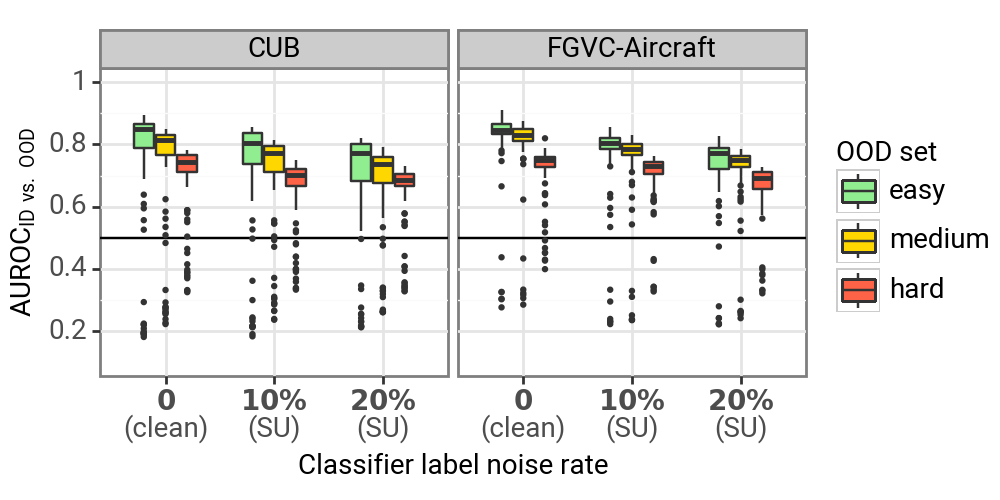

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 5 x 2.5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/OSR-per-difficulty-noise-rate_double_ds_emb.pdf


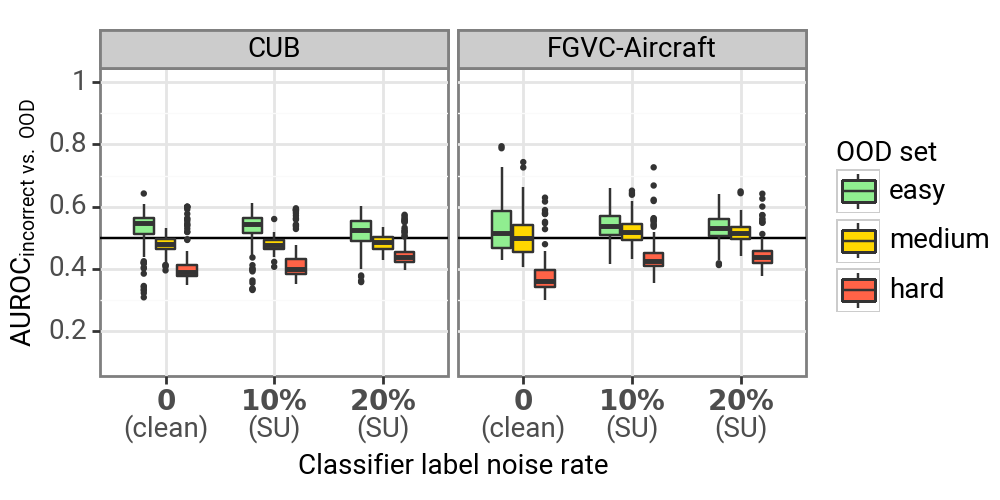

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 5 x 2.5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: paper_plots/OSR-incorrect-per-difficulty-noise-rate_double_ds_emb.pdf


In [16]:
plt = (ggplot(df_20_osr, aes(x="noise_rate_nice", y=f"auroc", fill="ood_dataset_nice"))
 + geom_hline(yintercept=0.5)
 + geom_boxplot(outlier_size=0.3, width=0.6)
 + facet_wrap("iid_dataset_nice")
 + theme_bw2()
 + scale_x_discrete(name="Classifier label noise rate")
 + scale_linetype_discrete(name="Noise rate")
 + scale_fill_manual(name="OOD set", values = {"easy": "lightgreen", "medium": "gold", "hard": "tomato"})
 + scale_y_continuous(name="$AUROC_{ID~vs.~OOD}$",limits=(0.1,1),breaks=[0.2,0.4,0.6,0.8,1])
 + theme(figure_size=(5,2.5),
         strip_text = element_text(size=10, color="black",margin={'t': 2, 'b': 2, 'l': 1, 'r': 1}),
        )
)
print(plt)
plt.save(f"paper_plots/OSR-per-difficulty-noise-rate_double_ds_emb.pdf")

plt = (ggplot(df_20_osr, aes(x="noise_rate_nice", y=f"incorrect_ood_auroc", fill="ood_dataset_nice"))
 + geom_hline(yintercept=0.5)
 + geom_boxplot(outlier_size=0.3, width=0.6)
 + facet_wrap("iid_dataset_nice")
 + theme_bw2()
 + scale_x_discrete(name="Classifier label noise rate")
 + scale_linetype_discrete(name="Noise rate")
 + scale_fill_manual(name="OOD set", values = {"easy": "lightgreen", "medium": "gold", "hard": "tomato"})
 + scale_y_continuous(name="$AUROC_{incorrect~vs.~OOD}$",limits=(0.1,1),breaks=[0.2,0.4,0.6,0.8,1])
 + theme(figure_size=(5,2.5),strip_text = element_text(size=10, color="black",margin={'t': 2, 'b': 2, 'l': 1, 'r': 1}))
)
print(plt)
plt.save(f"paper_plots/OSR-incorrect-per-difficulty-noise-rate_double_ds_emb.pdf")

# Supplementary <a id="suppl"></a>

In [17]:
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import sys

from PIL import Image, ImageFont, ImageDraw, ImageOps

sys.path.insert(len(sys.path), '../data/images_classic/CIFAR-N')
from cls_names import *

## Figure 1 (Supplementary)

In [18]:
txt_root = f"../data/benchmark_imglist"
img_root = f"../data/images_classic"
np.random.seed(2)

split = "train"
#dataset = "clothing1m"
dataset = "cifar10-worse"
#dataset = "cifar100-fine"
if dataset == "clothing1m":
    path_clean_txt = f"{txt_root}/clothing1M/{split}_clothing1M_clean.txt"
    path_noisy_txt = f"{txt_root}/clothing1M/{split}_clothing1M_noisy.txt"
    classname_dict = classname_dict_clothing
    border=50
    font_size=22
elif dataset == "cifar10-worse":
    path_clean_txt=f"{txt_root}/cifar10/{split}_cifar10.txt"
    path_noisy_txt=f"{txt_root}/cifar10/{split}_cifar10n_worse.txt"
    classname_dict = classname_dict_cifar
    border=50
    font_size=22
elif dataset == "cifar100-fine":
    path_clean_txt=f"{txt_root}/cifar100/{split}_cifar100.txt"
    path_noisy_txt=f"{txt_root}/cifar100/{split}_cifar100n_noisyfine.txt"
    classname_dict = classname_dict_cifar100
    border=50
    font_size=22
    

clean_labels = pd.read_csv(path_clean_txt, header=None, sep=' ')
clean_labels.columns = ['image', 'label_clean']

noisy_labels = pd.read_csv(path_noisy_txt, header=None, sep=' ')
noisy_labels.columns = ['image', 'label_noisy']

df_labels = pd.merge(clean_labels, noisy_labels, on="image", how="inner")
df_incorrect = df_labels[df_labels["label_clean"] != df_labels["label_noisy"]]

df_incorrect["label_clean"] = df_incorrect["label_clean"].apply(lambda x: classname_dict[x].replace("_"," "))
df_incorrect["label_noisy"] = df_incorrect["label_noisy"].apply(lambda x: classname_dict[x].replace("_"," "))

idx = np.random.choice(range(len(df_incorrect)),100)
#idx = range(len(df_incorrect))
img_selected = [list(df_incorrect["image"])[i] for i in idx]
clean_labels = [list(df_incorrect["label_clean"])[i] for i in idx]
noisy_labels = [list(df_incorrect["label_noisy"])[i] for i in idx]

desired_size = 224

img_selected_paths = [f"{img_root}/{img_path}" for img_path in img_selected]

for filename, path, clean, noisy in zip(img_selected,img_selected_paths,clean_labels,noisy_labels):
    print(filename,path)
    img = Image.open(path).resize((desired_size,desired_size))
    img = ImageOps.expand(img, border=border, fill=(255,255,255))
    draw = ImageDraw.Draw(img)
    font = ImageFont.truetype("fonts/Arial.ttf", font_size)
    draw.text((int(border/2),0),f"{clean}\nwrongly labeled as {noisy}",(0,0,0),font=font)
    #display(img)
    #break
    f = filename.split('/')[-2] + filename.split('/')[-1] if "cifar" in dataset else filename.split('/')[-1]
    Path(f"data_viz/{dataset}_mistakes/").mkdir(parents=True, exist_ok=True)
    img.save(f"data_viz/{dataset}_mistakes/{f}")
    print(f"{clean} wrongly labeled as {noisy}")

cifar10/train/dog/0273.png ../data/images_classic/cifar10/train/dog/0273.png
dog wrongly labeled as horse
cifar10/train/truck/4542.png ../data/images_classic/cifar10/train/truck/4542.png
truck wrongly labeled as automobile
cifar10/train/ship/2526.png ../data/images_classic/cifar10/train/ship/2526.png
ship wrongly labeled as automobile
cifar10/train/automobile/4529.png ../data/images_classic/cifar10/train/automobile/4529.png
automobile wrongly labeled as truck
cifar10/train/cat/4059.png ../data/images_classic/cifar10/train/cat/4059.png
cat wrongly labeled as bird
cifar10/train/horse/4717.png ../data/images_classic/cifar10/train/horse/4717.png
horse wrongly labeled as automobile
cifar10/train/ship/1458.png ../data/images_classic/cifar10/train/ship/1458.png
ship wrongly labeled as bird
cifar10/train/cat/2891.png ../data/images_classic/cifar10/train/cat/2891.png
cat wrongly labeled as dog
cifar10/train/ship/3810.png ../data/images_classic/cifar10/train/ship/3810.png
ship wrongly labeled as

## Figures 2 & 3 (Supplementary)

CIFAR Agg - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.09009999999999996
CIFAR Random1 - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.17234000000000005
CIFAR Worse - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.40208


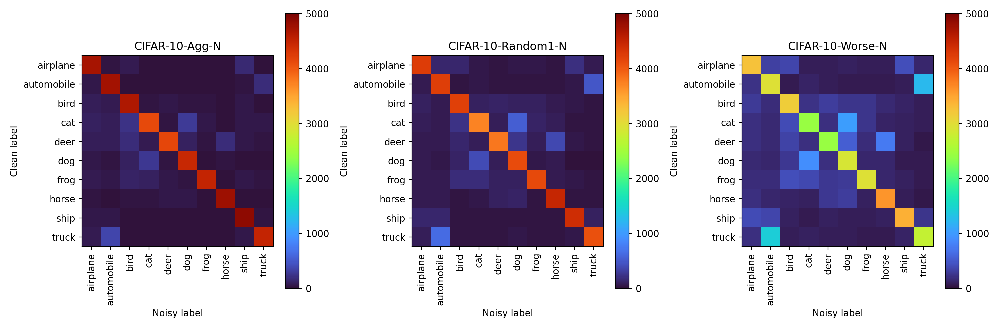

CIFARSymm Agg - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.09009999999999996
CIFARSymm Random1 - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.17234000000000005
CIFARSymm Worse - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.40208


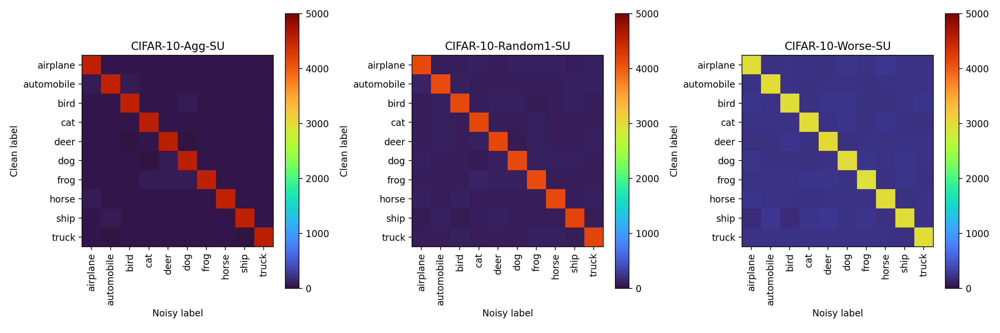

Clothing1M - Found 24637 clean labels and 24637 noisy labels.
Noise rate 0.38263587287413237


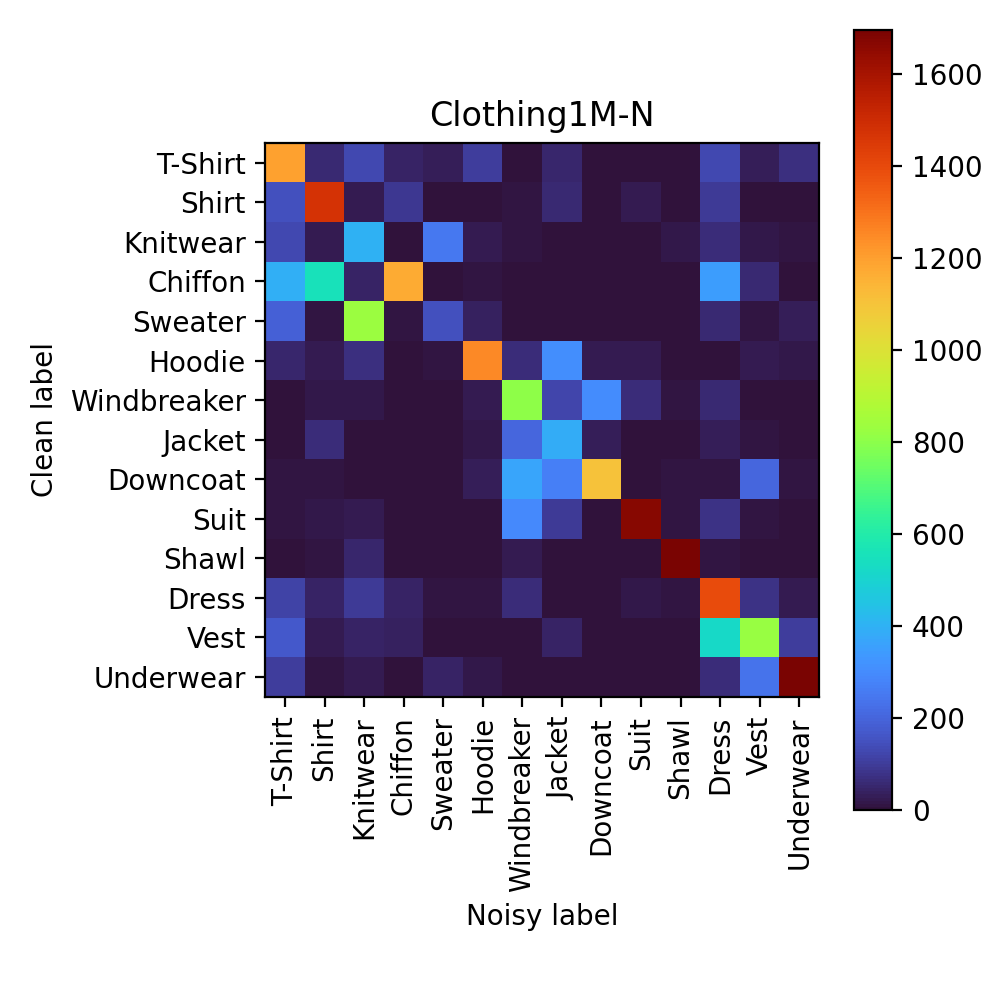

Clothing1M - Found 24637 clean labels and 24637 noisy labels.
Noise rate 0.0


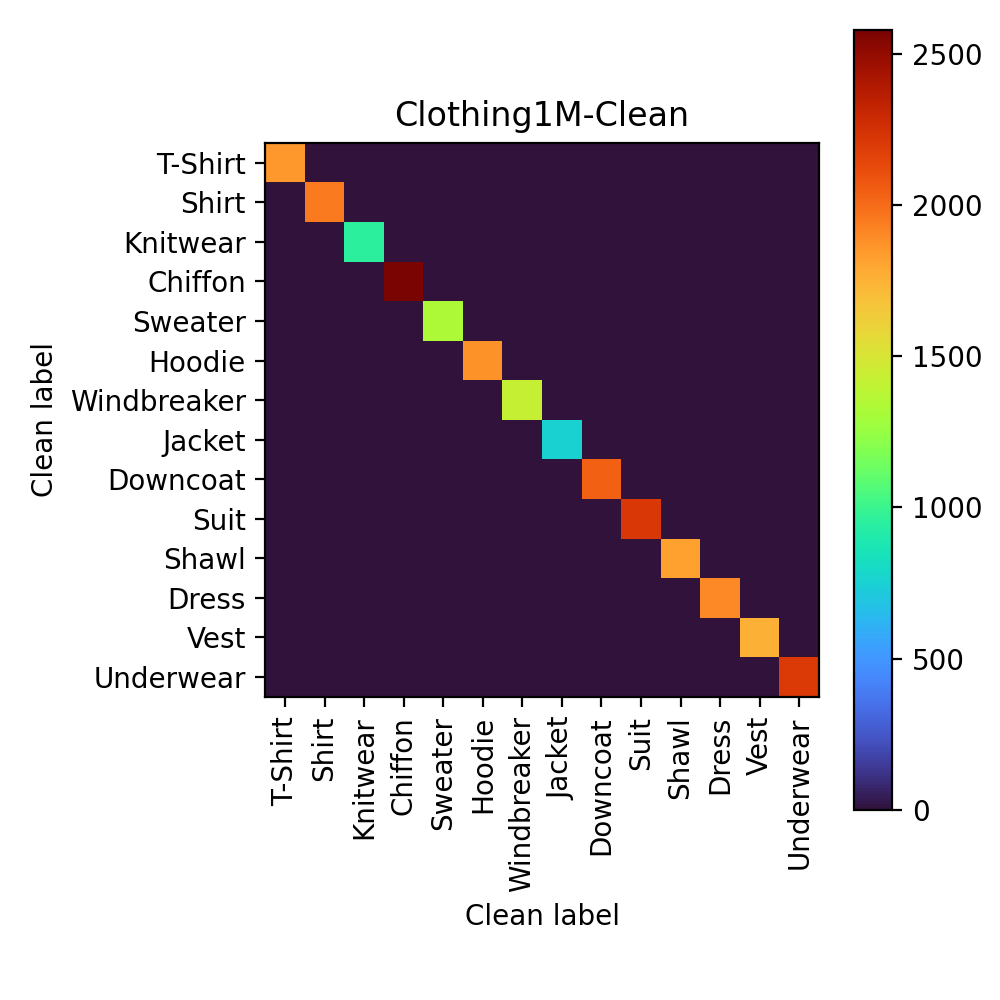

Clothing1M - Found 24637 clean labels and 24637 noisy labels.
Noise rate 0.38263587287413237


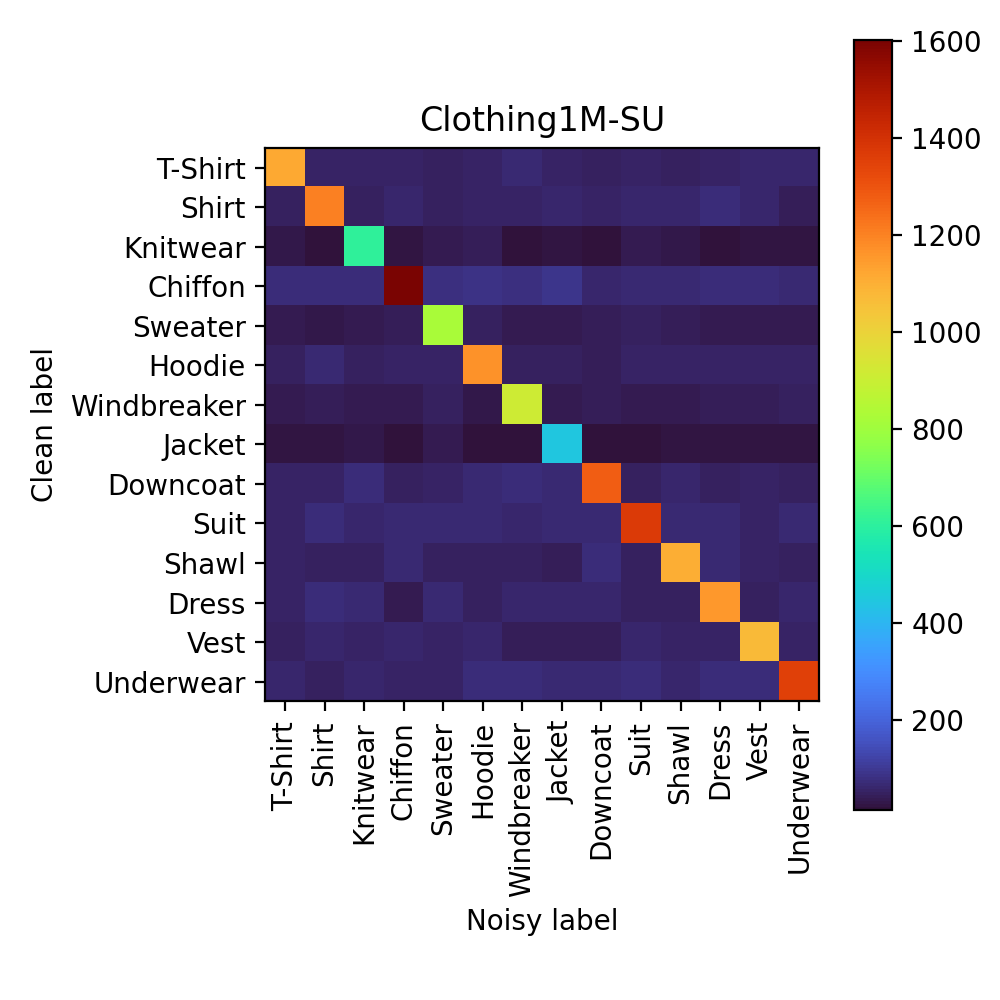

CIFAR-100N Coarse - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.26404000000000005


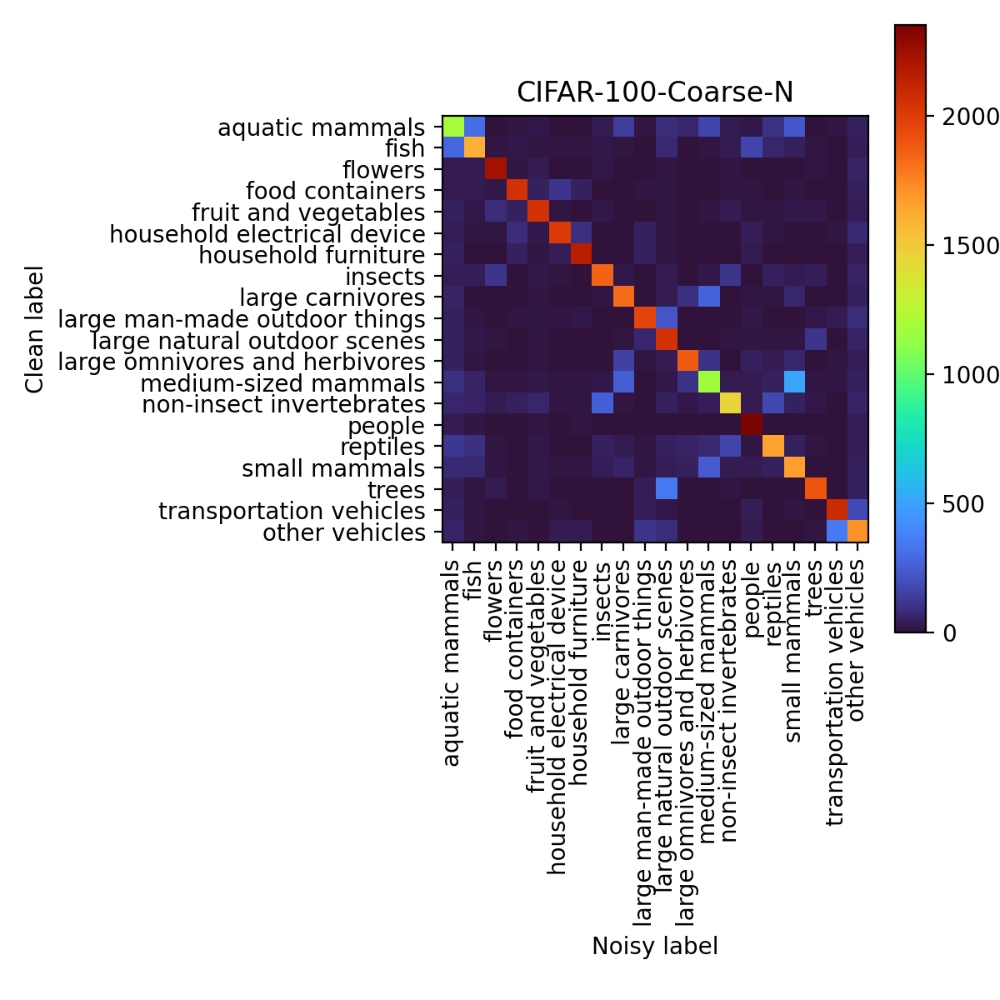

CIFAR-100Symm Coarse - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.26404000000000005


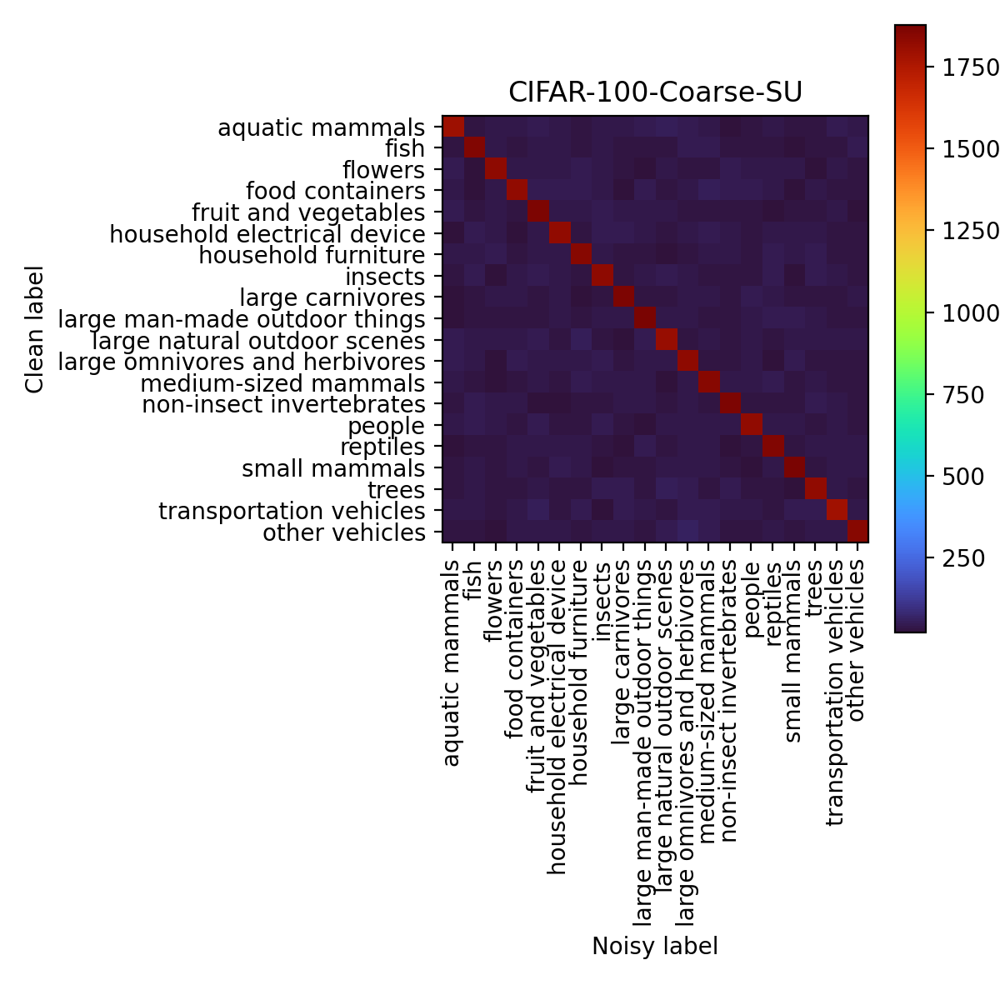

CIFAR-100 Fine - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.402


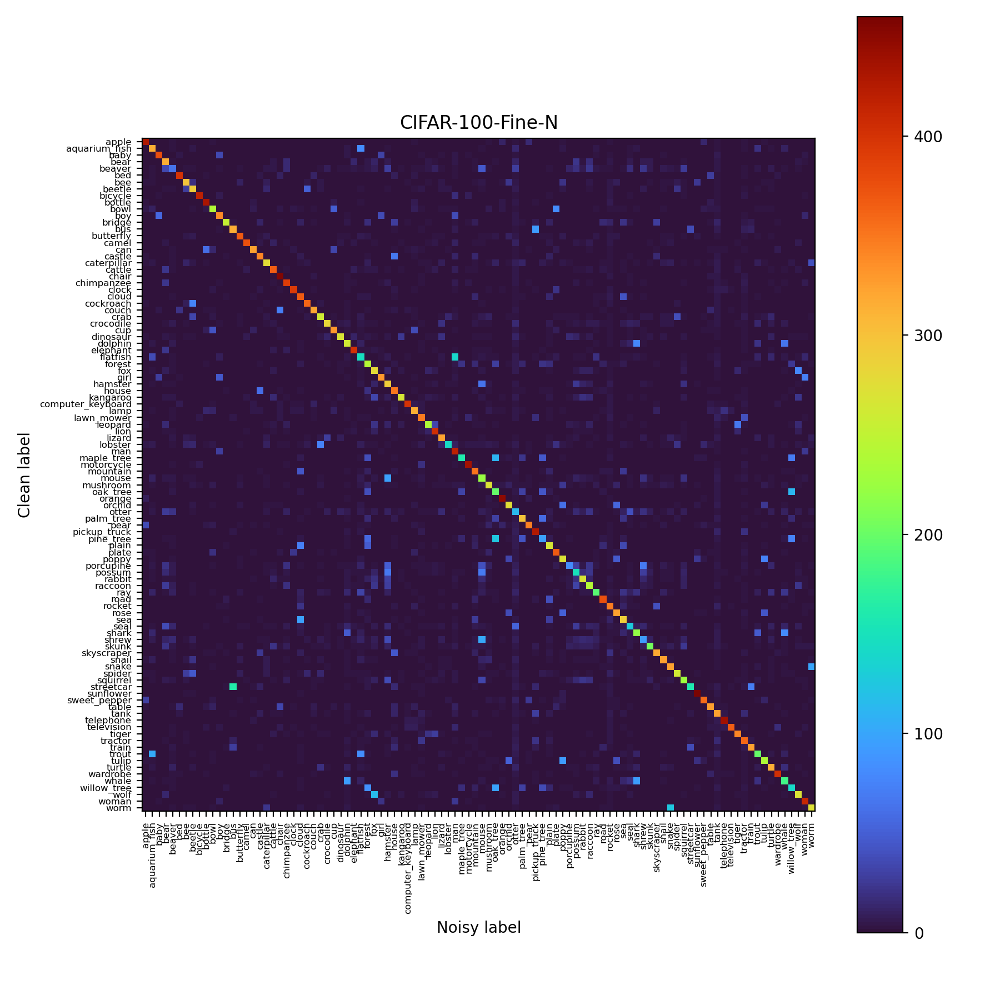

CIFAR-100Symm Coarse - Found 50000 clean labels and 50000 noisy labels.
Noise rate 0.402


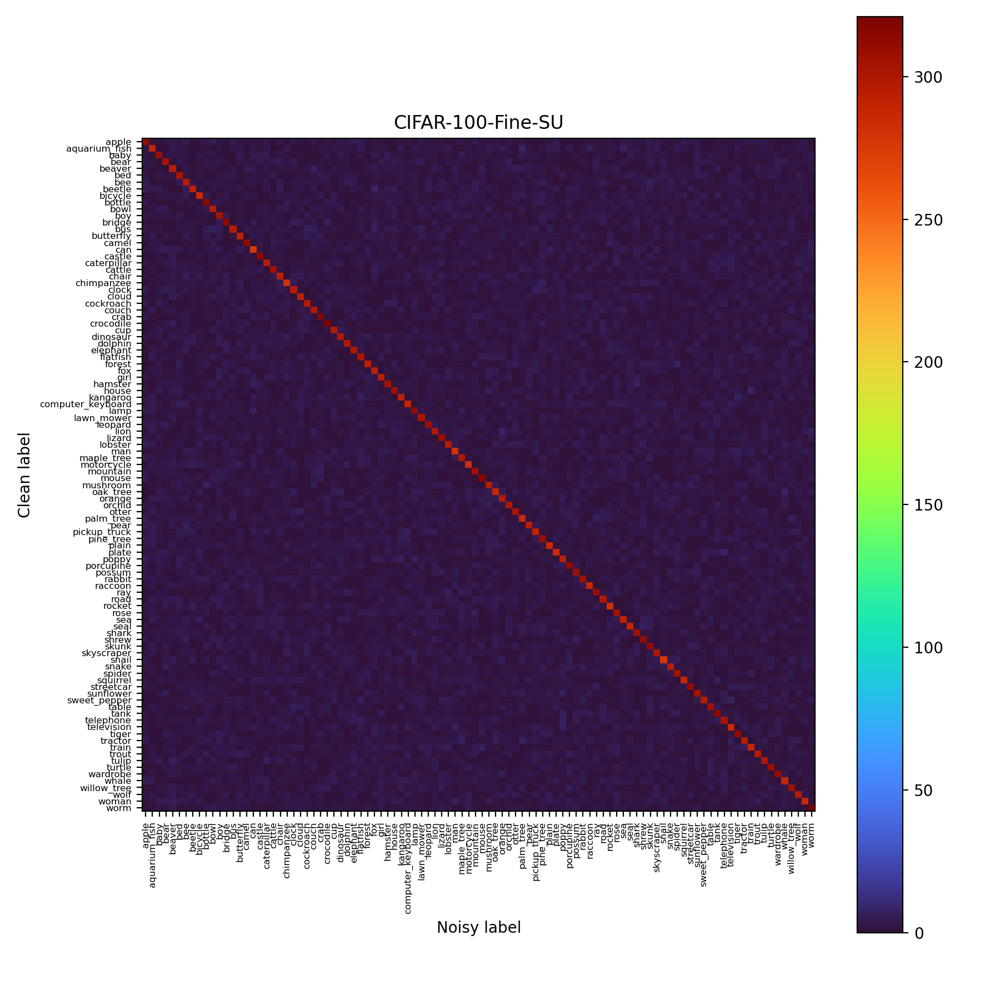

In [19]:
def get_confusion_matrix(path_clean_txt, path_noisy_txt, extra_info="", normalize=False):
    """
    Get the confusion matrix from the clean and noisy txt files.
    """
    try:
        clean_labels = pd.read_csv("../data/benchmark_imglist/"+path_clean_txt, header=None, sep=' ')
        clean_labels.columns = ['image', 'label_clean']
        noisy_labels = pd.read_csv("../data/benchmark_imglist/"+path_noisy_txt, header=None, sep=' ')
        noisy_labels.columns = ['image', 'label_noisy']
    except:
        clean_labels = pd.read_csv(path_clean_txt, header=None, sep=' ')
        clean_labels.columns = ['image', 'label_clean']
        noisy_labels = pd.read_csv(path_noisy_txt, header=None, sep=' ')
        noisy_labels.columns = ['image', 'label_noisy']

    print(f"{extra_info} - Found {len(clean_labels)} clean labels and {len(noisy_labels)} noisy labels.")

    # merge the two dataframes
    df = pd.merge(clean_labels, noisy_labels, on="image", how="inner")
    noise_rate = 1 - np.sum(df["label_clean"] == df["label_noisy"]) / len(df)
    print(f"Noise rate {noise_rate}")
    
    # get the confusion matrix
    confusion_matrix = pd.crosstab(df['label_clean'], df['label_noisy'],normalize=normalize)

    return confusion_matrix

CMAP = 'turbo'
split = 'train'
cms_cifar = dict()
cifar_subsets = ["Agg","Random1","Worse"]

# reverse the dictionary

for subset in cifar_subsets:
    cms_cifar[subset] = get_confusion_matrix(
                            path_clean_txt=f"cifar10/{split}_cifar10.txt",
                            path_noisy_txt=f"cifar10/{split}_cifar10n_{subset.lower()}.txt",
                            extra_info=f"CIFAR {subset}"
                        )
# plot them side by side
fig, ax = plt.subplots(1, len(cifar_subsets), figsize=(len(cifar_subsets)*5, 5))
#ax = [ax]
for i,subset in enumerate(cifar_subsets):
    c = ax[i].imshow(cms_cifar[subset], cmap=CMAP, vmin=0, vmax=5000)
    ax[i].set_xticks([i for i in range(10)])
    ax[i].set_xlabel("Noisy label")
    ax[i].set_ylabel("Clean label")
    ax[i].set_yticks([i for i in range(10)])
    ax[i].set_xticklabels([classname_dict_cifar[i] for i in range(10)], rotation=90)
    ax[i].set_yticklabels([classname_dict_cifar[i] for i in range(10)])
    ax[i].set_title(f"CIFAR-10-{subset}-N")
    plt.colorbar(c)

plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-N noise transition matrix.pdf")
plt.show()


for subset in cifar_subsets:
    cms_cifar[subset] = get_confusion_matrix(
                            path_clean_txt=f"cifar10/{split}_cifar10.txt",
                            path_noisy_txt=f"cifar10/{split}_cifar10symm_{subset.lower()}.txt",
                            extra_info=f"CIFARSymm {subset}"
                        )
# plot them side by side
fig, ax = plt.subplots(1, len(cifar_subsets), figsize=(len(cifar_subsets)*5, 5))
#ax = [ax]
for i,subset in enumerate(cifar_subsets):
    c = ax[i].imshow(cms_cifar[subset], cmap=CMAP, vmin=0, vmax=5000)
    ax[i].set_xticks([i for i in range(10)])
    ax[i].set_xlabel("Noisy label")
    ax[i].set_ylabel("Clean label")
    ax[i].set_yticks([i for i in range(10)])
    ax[i].set_xticklabels([classname_dict_cifar[i] for i in range(10)], rotation=90)
    ax[i].set_yticklabels([classname_dict_cifar[i] for i in range(10)])
    ax[i].set_title(f"CIFAR-10-{subset}-SU")
    plt.colorbar(c)
plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-Symm noise transition matrix.pdf")
plt.show()

cm_clothing1M = get_confusion_matrix(
                        path_clean_txt=f"clothing1M/{split}_clothing1M_clean.txt",
                        path_noisy_txt=f"clothing1M/{split}_clothing1M_noisy.txt",
                        extra_info=f"Clothing1M"
            )

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
c = ax.imshow(cm_clothing1M, cmap=CMAP)
plt.colorbar(c)
ax.set_title("Clothing1M-N")
ax.set_xticks([i for i in range(14)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(14)])
ax.set_xticklabels([classname_dict_clothing[i] for i in range(14)], rotation=90)
ax.set_yticklabels([classname_dict_clothing[i] for i in range(14)])
plt.tight_layout()
plt.savefig(f"data_viz/Clothing1M-Noisy transition matrix.pdf")
plt.show()

cm_clothing1M = get_confusion_matrix(
                        path_clean_txt=f"clothing1M/{split}_clothing1M_clean.txt",
                        path_noisy_txt=f"clothing1M/{split}_clothing1M_clean.txt",
                        extra_info=f"Clothing1M"
            )

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
c = ax.imshow(cm_clothing1M, cmap=CMAP)
plt.colorbar(c)
ax.set_title("Clothing1M-Clean")
ax.set_xticks([i for i in range(14)])
ax.set_xlabel("Clean label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(14)])
ax.set_xticklabels([classname_dict_clothing[i] for i in range(14)], rotation=90)
ax.set_yticklabels([classname_dict_clothing[i] for i in range(14)])
plt.tight_layout()
plt.savefig(f"data_viz/Clothing1M-Clean transition matrix.pdf")
plt.show()

cm_clothing1M = get_confusion_matrix(
                        path_clean_txt=f"clothing1M/{split}_clothing1M_clean.txt",
                        path_noisy_txt=f"clothing1M/{split}_clothing1M_symm.txt",
                        extra_info=f"Clothing1M"
            )

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
c = ax.imshow(cm_clothing1M, cmap=CMAP)
plt.colorbar(c)
ax.set_title("Clothing1M-SU")
ax.set_xticks([i for i in range(14)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(14)])
ax.set_xticklabels([classname_dict_clothing[i] for i in range(14)], rotation=90)
ax.set_yticklabels([classname_dict_clothing[i] for i in range(14)])
plt.tight_layout()
plt.savefig(f"data_viz/Clothing1M-Symm transition matrix.pdf")
plt.show()

cm_cifar100coarse = get_confusion_matrix(
                        path_clean_txt=f"cifar100/{split}_cifar100n_cleancoarse.txt",
                        path_noisy_txt=f"cifar100/{split}_cifar100n_noisycoarse.txt",
                        extra_info=f"CIFAR-100N Coarse"
            )

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
c = ax.imshow(cm_cifar100coarse, cmap=CMAP)
plt.colorbar(c)
ax.set_title("CIFAR-100-Coarse-N")
ax.set_xticks([i for i in range(20)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(20)])
ax.set_xticklabels([classname_dict_cifar100_coarse[i] for i in range(20)], rotation=90)
ax.set_yticklabels([classname_dict_cifar100_coarse[i] for i in range(20)])
plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-100N Coarse transition matrix.pdf")
plt.show()

cm_cifar100coarse = get_confusion_matrix(
                        path_clean_txt=f"cifar100/{split}_cifar100n_cleancoarse.txt",
                        path_noisy_txt=f"cifar100/{split}_cifar100symm_noisycoarse.txt",
                        extra_info=f"CIFAR-100Symm Coarse"
            )

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
c = ax.imshow(cm_cifar100coarse, cmap=CMAP)
plt.colorbar(c)
ax.set_title("CIFAR-100-Coarse-SU")
ax.set_xticks([i for i in range(20)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(20)])
ax.set_xticklabels([classname_dict_cifar100_coarse[i] for i in range(20)], rotation=90)
ax.set_yticklabels([classname_dict_cifar100_coarse[i] for i in range(20)])
plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-100Symm Coarse transition matrix.pdf")
plt.show()

cm_cifar100fine = get_confusion_matrix(
                        path_clean_txt=f"cifar100/{split}_cifar100.txt",
                        path_noisy_txt=f"cifar100/{split}_cifar100n_noisyfine.txt",
                        extra_info=f"CIFAR-100 Fine"
            )

fig, ax = plt.subplots(1, 1, figsize=(9, 9))
c = ax.imshow(cm_cifar100fine, cmap=CMAP)
plt.colorbar(c)
ax.set_title("CIFAR-100-Fine-N")
ax.set_xticks([i for i in range(100)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(100)])
ax.set_xticklabels([classname_dict_cifar100[i] for i in range(100)], rotation=90, fontsize=6)
ax.set_yticklabels([classname_dict_cifar100[i] for i in range(100)], fontsize=6)
plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-100N Fine transition matrix.pdf")
plt.show()

cm_cifar100fine = get_confusion_matrix(
                        path_clean_txt=f"cifar100/{split}_cifar100.txt",
                        path_noisy_txt=f"cifar100/{split}_cifar100symm_noisyfine.txt",
                        extra_info=f"CIFAR-100Symm Coarse"
            )

fig, ax = plt.subplots(1, 1, figsize=(9, 9))
c = ax.imshow(cm_cifar100fine, cmap=CMAP)
plt.colorbar(c)
ax.set_title("CIFAR-100-Fine-SU")
ax.set_xticks([i for i in range(100)])
ax.set_xlabel("Noisy label")
ax.set_ylabel("Clean label")
ax.set_yticks([i for i in range(100)])
ax.set_xticklabels([classname_dict_cifar100[i] for i in range(100)], rotation=90, fontsize=6)
ax.set_yticklabels([classname_dict_cifar100[i] for i in range(100)], fontsize=6)
plt.tight_layout()
plt.savefig(f"data_viz/CIFAR-100Symm Fine transition matrix.pdf")
plt.show()

## Figure 4 (Supplementary)

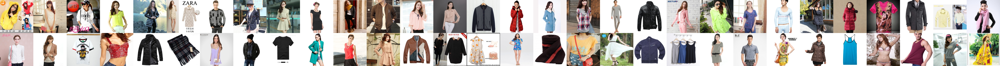

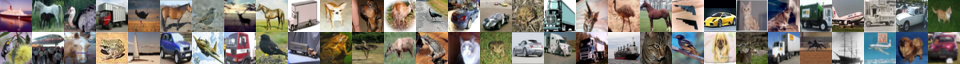

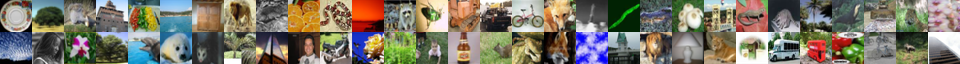

In [20]:
np.random.seed(10)
txt_root = f"../data/benchmark_imglist"
split="train"

txt_paths = {
    "clothing1M": f"{txt_root}/clothing1M/{split}_clothing1M_clean.txt",
    "cifar10": f"{txt_root}/cifar10/{split}_cifar10.txt",
    "cifar100": f"{txt_root}/cifar100/{split}_cifar100.txt",
}
resize_to = {
    "clothing1M": 256,
    "cifar10": 32,
    "cifar100": 32,
}

num_images = 60
split_at = 30

for dataset in txt_paths.keys():
    img_root = f"../data/images_classic"
    path_clean_txt=txt_paths[dataset]
    
    clean_labels = pd.read_csv(path_clean_txt, header=None, sep=' ')
    clean_labels.columns = ['image', 'label_clean']
    
    img_selected = []
        
    idx = np.random.choice(range(len(clean_labels["image"])),num_images)
    img_selected.extend([list(clean_labels["image"])[i] for i in idx])
        
    img_selected_paths = [f"{img_root}/{img_path}" for img_path in img_selected]
    
    desired_size = resize_to[dataset]
    images = [Image.open(x).resize((desired_size,desired_size)) if (Image.open(x).size[0] != desired_size or Image.open(x).size[1] != desired_size) else Image.open(x) for x in img_selected_paths]
    widths, heights = zip(*(i.size for i in images))
    
    total_width = int(sum(widths) / (num_images/split_at))
    max_height = int(max(heights) * (num_images/split_at))
    
    new_im = Image.new('RGB', (total_width, max_height))
    
    x_offset = 0
    for i,im in enumerate(images):
      if i < split_at:
          y_offset = 0
      elif (i % split_at) == 0:
          y_offset = desired_size * (i // split_at)
          x_offset = 0
      new_im.paste(im, (x_offset,y_offset))
      #print(im.size)
      x_offset += im.size[0]
    
    display(new_im)
    new_im.save(f"data_viz/{dataset}-example-per-class.png")

## Figure 5 (Supplementary)

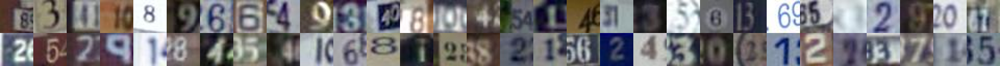

data_viz/svhn-examples.png


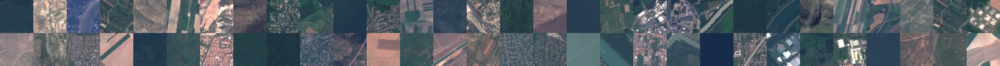

data_viz/eurosat-examples.png


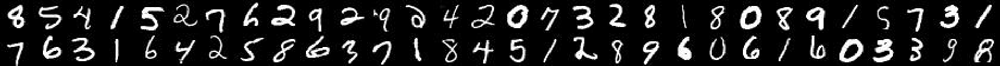

data_viz/mnist-examples.png


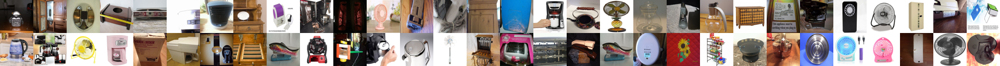

data_viz/stanfordproducts-examples.png


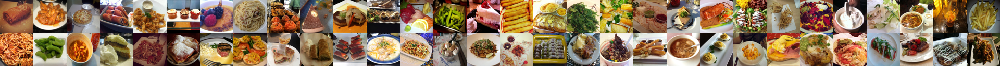

data_viz/food101-examples.png


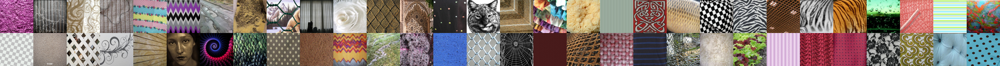

data_viz/texture-examples.png


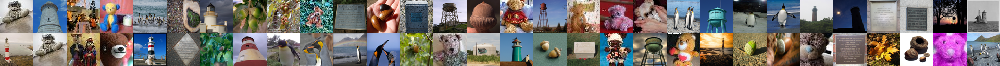

data_viz/imagenet_test-examples.png


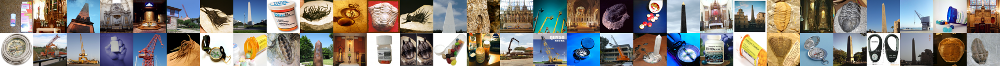

data_viz/imagenet_val-examples.png


In [21]:
np.random.seed(10)
txt_root = f"../data/benchmark_imglist"

resize_to = 64

datasets = {
    "test": ["svhn","eurosat","mnist","stanfordproducts","food101","texture","imagenet"],
    "val": ["imagenet"],
}

num_images = 60
split_at = 30

for split in ["test","val"]:
    for dataset in datasets[split]:
        
        img_root = f"../data/images_classic"
        txt_paths = {
            "imagenet": f"{txt_root}/imagenet/imagenet6_ood_{split}.txt",
        }
        
        for o in [f"{txt_root}/{dataset}/{split}_{dataset}.txt",
                  f"{txt_root}/{dataset}/{dataset}_{split}_ood.txt",
                  f"{txt_root}/{dataset}/{dataset}_{split}.txt",
                  f"{txt_root}/cifar100/{split}_{dataset}.txt"]:
            try:
                path_clean_txt=txt_paths.get(dataset, o)
                clean_labels = pd.read_csv(path_clean_txt, header=None, sep=' ')
                break
            except:
                continue
        
        
        clean_labels.columns = ['image', 'label_clean']
        
        img_selected = []
        
        idx = np.random.choice(range(len(clean_labels["image"])),num_images)
        img_selected.extend([list(clean_labels["image"])[i] for i in idx])
            
        img_selected_paths = [f"{img_root}/{img_path}" for img_path in img_selected]
        
        desired_size = resize_to
        images = [Image.open(x).resize((desired_size,desired_size)) if (Image.open(x).size[0] != desired_size or Image.open(x).size[0] != desired_size) else Image.open(x) for x in img_selected_paths]
        widths, heights = zip(*(i.size for i in images))
        
        total_width = int(sum(widths) / (num_images/split_at))
        max_height = int(max(heights) * (num_images/split_at))
        
        new_im = Image.new('RGB', (total_width, max_height))
        
        x_offset = 0
        for i,im in enumerate(images):
          if i < split_at:
              y_offset = 0
          elif (i % split_at) == 0:
              y_offset = desired_size * (i // split_at)
              x_offset = 0
          new_im.paste(im, (x_offset,y_offset))
          #print(im.size)
          x_offset += im.size[0]
        
        #new_im.show()
        display(new_im)
    
        if dataset == "imagenet":
            dataset_name = f"imagenet_{split}"
        else:
            dataset_name = dataset
    
        print(f"data_viz/{dataset_name}-examples.png")
        new_im.save(f"data_viz/{dataset_name}-examples.png")
        
        #plt.imshow(np.asarray(new_im))

## Figure 6 (Supplementary)

In [22]:
nice_noise_names = {"clean": "Clean", "real": "N", "asymm": "SCC", "symm": "SU"}

df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]
df_20_ood["noise_type"] = pd.Categorical(df_20_ood["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)
df_20_ood['noise_type_nice'] = df_20_ood['noise_type'].apply(lambda x: nice_noise_names[x])

nice_ood_names = {
    "mnist": "MNIST",
    "svhn": "SVHN",
    "eurosat": "EuroSAT",
    "imagenet6_test": "$ImageNet6_{test}$",
    "texture": "Texture",
    "stanfordproducts": "StanfordProducts",
    "food101": "Food101"}
df_20_ood["ood_dataset_nice"] = df_20_ood["ood_dataset"].apply(lambda x: nice_ood_names[x])

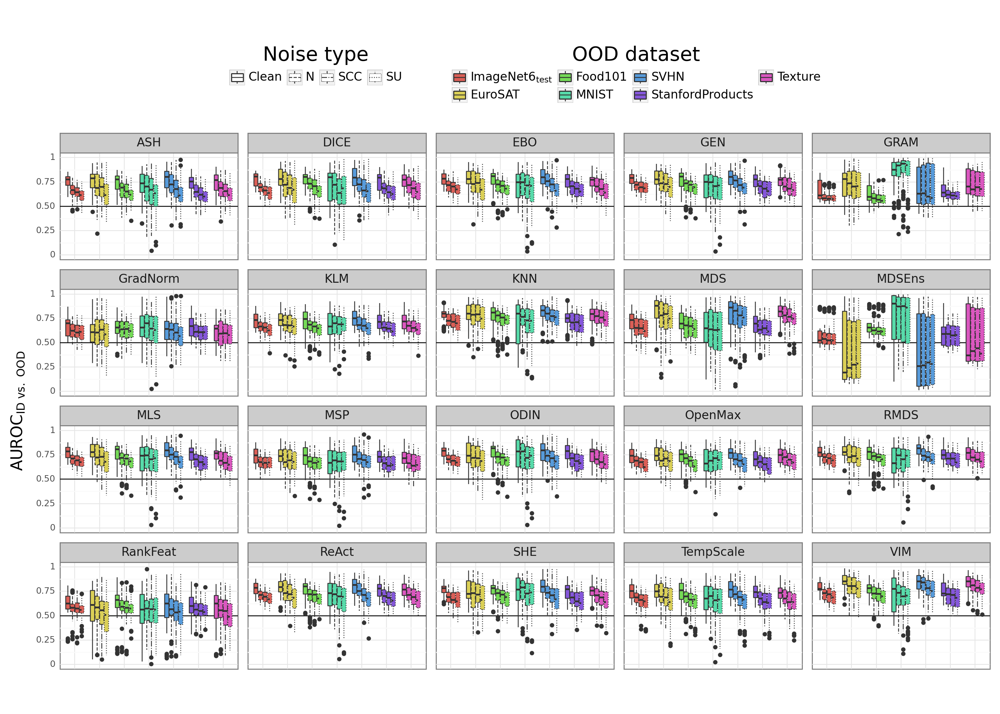

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 14 x 10 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/boxplots-per-ooddataset-noise_type.pdf


In [23]:
plt = (ggplot(df_20_ood, aes(x="ood_dataset_nice", y=f"auroc", linetype="noise_type_nice", fill="ood_dataset_nice"))
 + geom_hline(yintercept=0.5)
 + geom_boxplot()
 + facet_wrap("method_fmt",ncol=5)
 + theme_bw()
 + scale_x_discrete(name="")
 + scale_linetype_discrete(name="Noise type")
 + scale_fill_discrete(name="OOD dataset")
 + scale_y_continuous(name="$AUROC_{ID~vs.~OOD}$")
 + theme(figure_size=(14,10), aspect_ratio=0.6, axis_ticks=element_blank(), axis_text_x=element_blank(),
        legend_position='top',
        legend_title_align='center',
        legend_spacing=50,
        legend_title = element_text(size=20),
        legend_text = element_text(size=12),
        axis_title_y = element_text(size=16),
        axis_title_x = element_text(size=16),
        strip_text = element_text(size=12))
)
print(plt)
plt.save(f"supp_plots/boxplots-per-ooddataset-noise_type.pdf")

## Table 2 (Supplementary)

In [24]:
df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]
print(params)
aggregate_ood_dataset_func = lambda df: df.mean()
df_mean_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()

#df_mean_ood["auroc_fmt"] = df_mean_ood["auroc"].apply(lambda x: x*100)
df_mean_ood_best = df_mean_ood.groupby(["training_dataset_nice","method","method_fmt"])["auroc"].max().reset_index()
df_mean_ood_best["auroc_fmt"] = df_mean_ood_best["auroc"].apply(lambda x: x*100)

df_mean_ood_best_pivot = df_mean_ood_best.pivot_table('auroc_fmt', ['method_fmt'], 'training_dataset_nice')
print(df_mean_ood_best_pivot.to_markdown())
df_mean_ood_best_pivot.round(2).to_csv(f"supp_csvs/best_auroc_per_method_per_ds-mean_auroc.csv")


['method', 'method_nice', 'method_fmt', 'training_dataset', 'training_dataset_nice', 'ds_group', 'noisy_or_not', 'iid_dataset', 'iid_dataset_nice', 'checkpoint', 'arch', 'arch_nice', 'seed', 'noise_type', 'noise_rate', 'num_classes']
| method_fmt   |   CIFAR-10 |   CIFAR-10-Agg-N |   CIFAR-10-Agg-SCC |   CIFAR-10-Agg-SU |   CIFAR-10-Random1-N |   CIFAR-10-Random1-SCC |   CIFAR-10-Random1-SU |   CIFAR-10-Worse-N |   CIFAR-10-Worse-SCC |   CIFAR-10-Worse-SU |   CIFAR-100-Coarse |   CIFAR-100-Coarse-N |   CIFAR-100-Coarse-SCC |   CIFAR-100-Coarse-SU |   CIFAR-100-Fine |   CIFAR-100-Fine-N |   CIFAR-100-Fine-SCC |   CIFAR-100-Fine-SU |   Clothing1M |   Clothing1M-N |   Clothing1M-SCC |   Clothing1M-SU |
|:-------------|-----------:|-----------------:|-------------------:|------------------:|---------------------:|-----------------------:|----------------------:|-------------------:|---------------------:|--------------------:|-------------------:|---------------------:|--------------------

## Figure 7 (Supplementary)

In [25]:
import scipy

measure_metric = "accuracy"
corr_metric = "accuracy"
ood_metrics = ["accuracy","auroc","correct_ood_auroc","incorrect_ood_auroc","failure_auroc"]

corr_dict = {
    "Spearman": scipy.stats.spearmanr,
}

df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]

aggregate_ood_dataset_func = lambda df: df.median()
df_median_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()

summary_dicts = list()
for corr_type, corr_func in corr_dict.items(): 
    for method in df_median_ood["method_fmt"].unique():
        
        df_method = df_median_ood[df_median_ood["method_fmt"]==method]
        assert len(df_method) == 396, len(df_method)

        measure_metric = "auroc"
        corr_auroc, p_auroc = corr_func(df_method[f"{corr_metric}"], df_method[measure_metric])

        measure_metric = "correct_ood_auroc"
        corr_correct, p_correct = corr_func(df_method[f"{corr_metric}"], df_method[measure_metric])

        measure_metric = "incorrect_ood_auroc"
        corr_incorrect, p_incorrect = corr_func(df_method[f"{corr_metric}"], df_method[measure_metric])

        measure_metric = "failure_auroc"
        corr_failure, p_failure = corr_func(df_method[f"{corr_metric}"], df_method[measure_metric])
        
        summary_dicts.append({
                "method": method,
                "corr_auroc": corr_auroc,
                "p_auroc": p_auroc,
                "corr_correct": corr_correct,
                "p_correct": p_correct,
                "p_incorrect": p_incorrect,
                "corr_incorrect": corr_incorrect,
                "corr_type": corr_type,
                "corr_failure": corr_failure,
                "p_failure": p_failure
                })
    df_summary = pd.DataFrame(summary_dicts)

    print(f"max. p-value for accuracy vs. AUROC_ID-vs-OOD",df_summary["p_auroc"].max())
    print(f"max. p-value for accuracy vs. AUROC_correct-vs-OOD",df_summary["p_correct"].max())
    print(f"max. p-value for accuracy vs. AUROC_incorrect-vs-OOD",df_summary["p_incorrect"].max())

max. p-value for accuracy vs. AUROC_ID-vs-OOD 0.003815998022149441
max. p-value for accuracy vs. AUROC_correct-vs-OOD 0.009423324789313799
max. p-value for accuracy vs. AUROC_incorrect-vs-OOD 0.8127462791353761


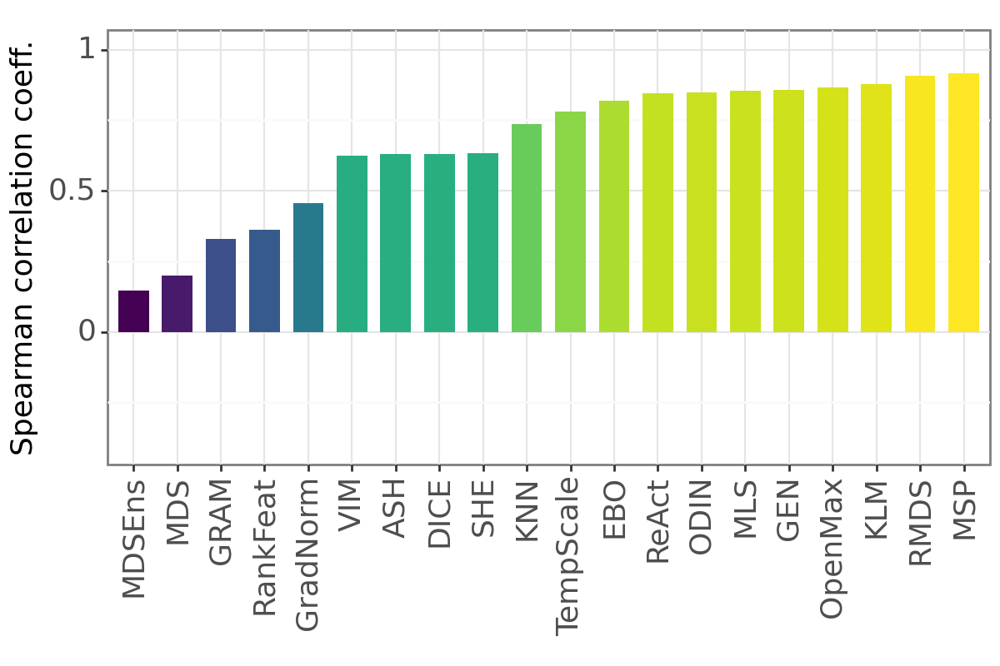

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 4 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/corr-accuracy-corr_auroc.pdf


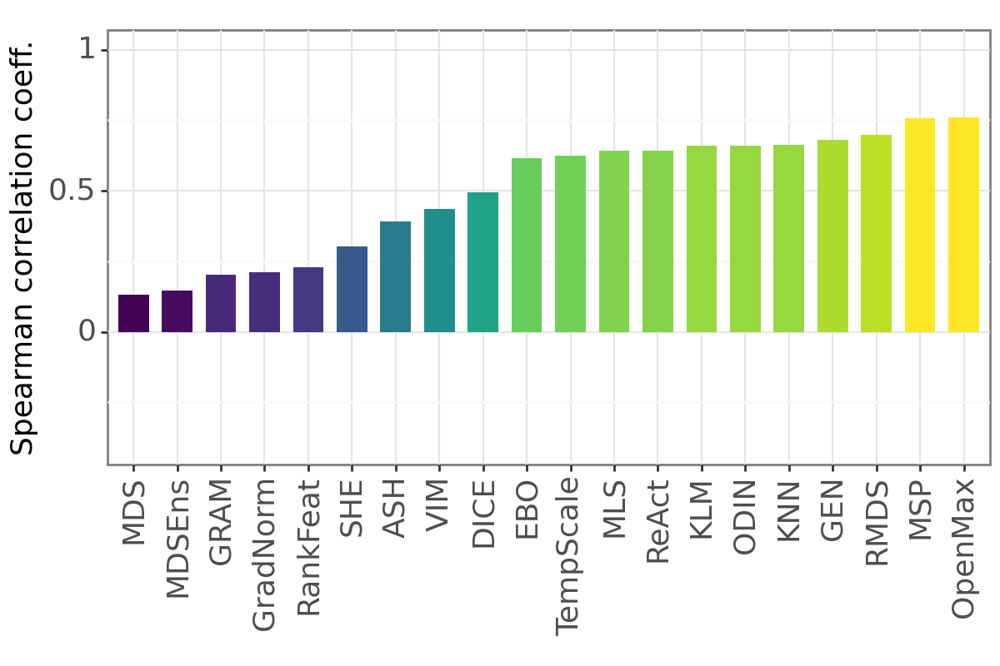

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 4 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/corr-accuracy-corr_correct.pdf


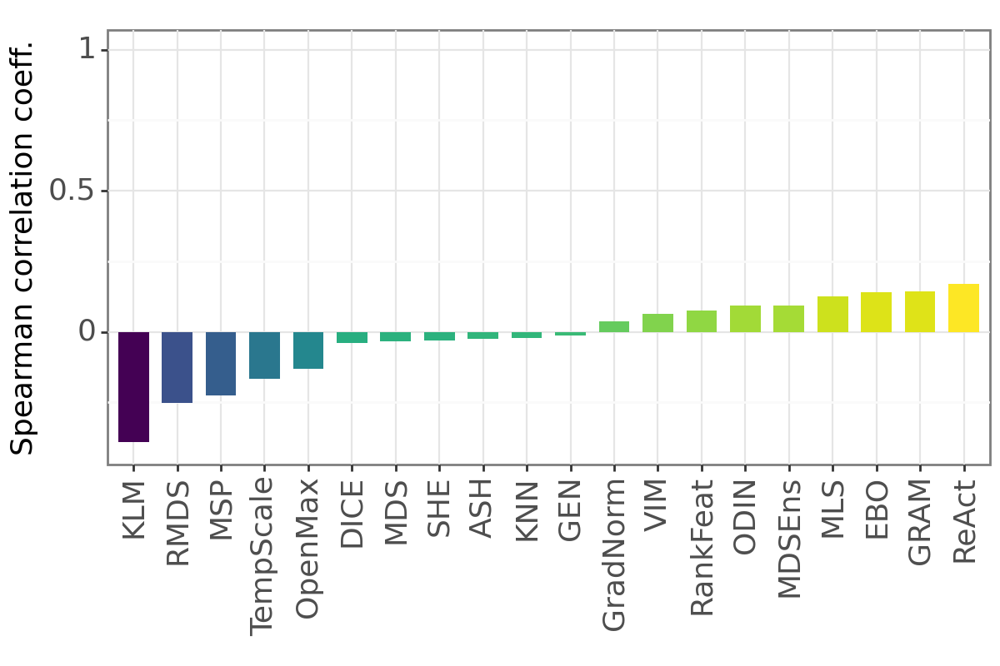

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 4 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/corr-accuracy-corr_incorrect.pdf


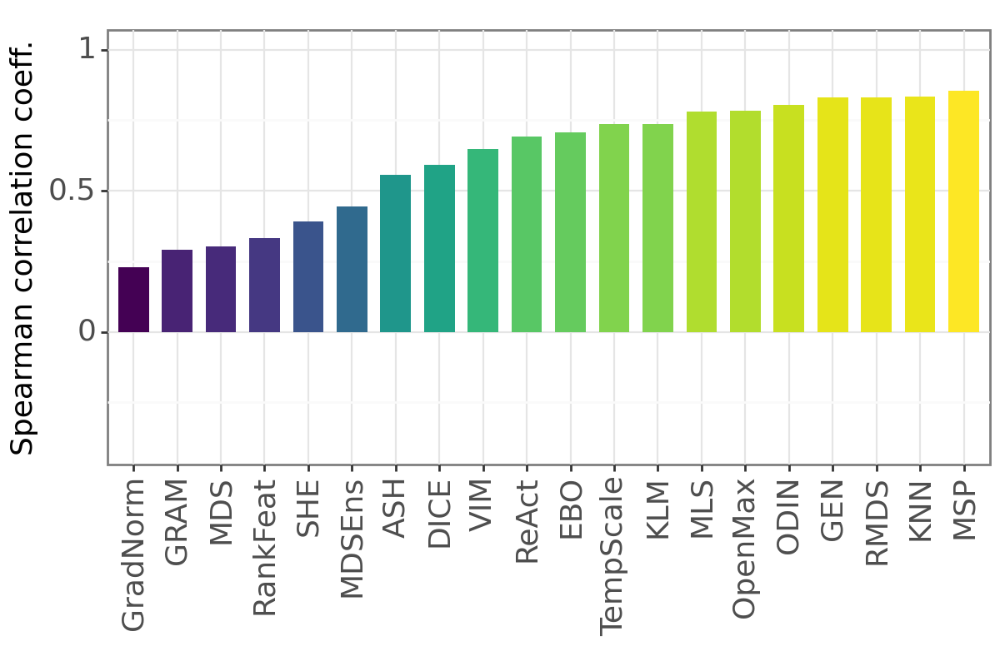

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 4 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/corr-accuracy-corr_failure.pdf


In [26]:
theme_text_sizes = theme(axis_text_x=element_text(size=13),
                         axis_text_y=element_text(size=13),
                         axis_title_x = element_text(size=13),
                         axis_title_y = element_text(size=13),
                         strip_text=element_text(size=14),
                         legend_text=element_text(size=12))

for measure in ["corr_auroc","corr_correct","corr_incorrect","corr_failure"]:
    plt = (ggplot(df_summary, aes(f"reorder(method,{measure})", measure, fill=measure))
     + geom_col(stat='identity', position='dodge', width=0.7)
     + theme_bw()
     + theme(
        legend_key_width=10,
        legend_key_height=30
       )
     + theme(figure_size=(6,4))
     
     
     + scale_x_discrete(name="")
     + scale_fill_continuous(guide=False)
     + scale_y_continuous(name="Spearman correlation coeff.",limits=(-0.4,1))
     + theme(axis_text_x=element_text(rotation=90, hjust="center"))
     + theme_text_sizes
    )
    print(plt)
    plt.save(f"supp_plots/corr-accuracy-{measure}.pdf")

## Figure 8 (Supplementary)

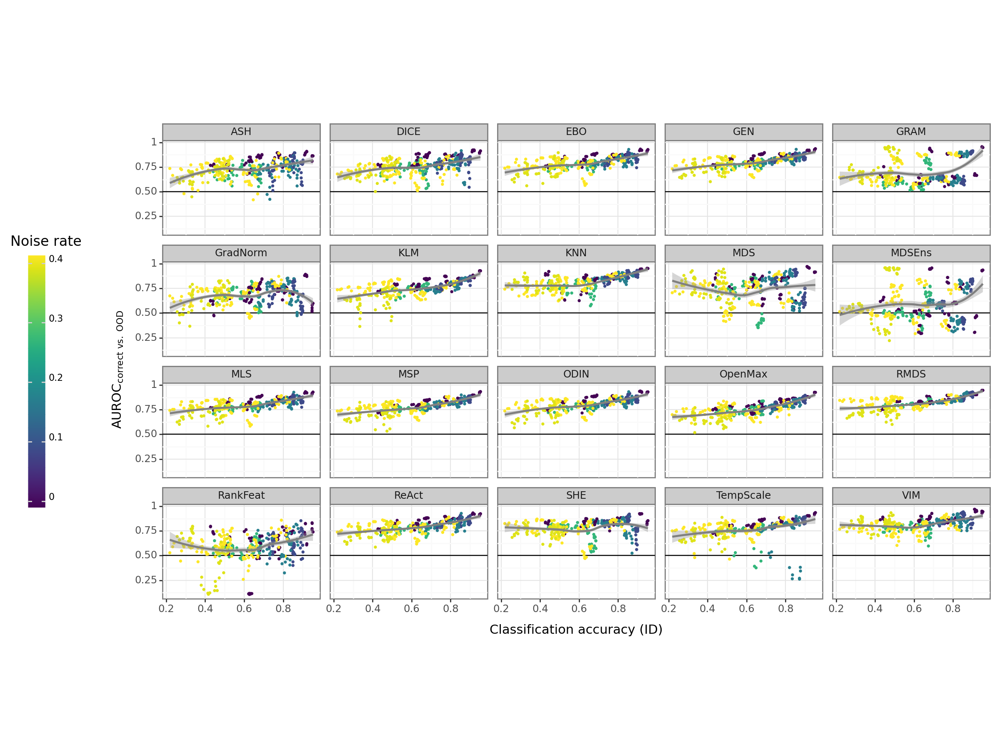

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-correctauroc-noise_rate-all.pdf


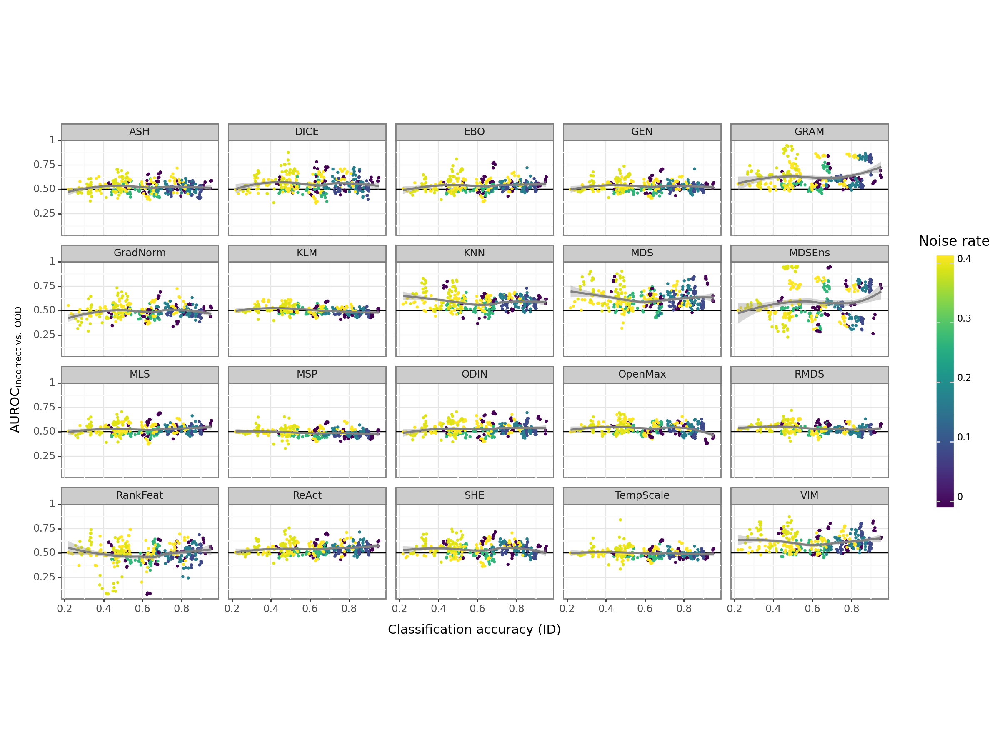

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-incorrectauroc-noise_rate-all.pdf


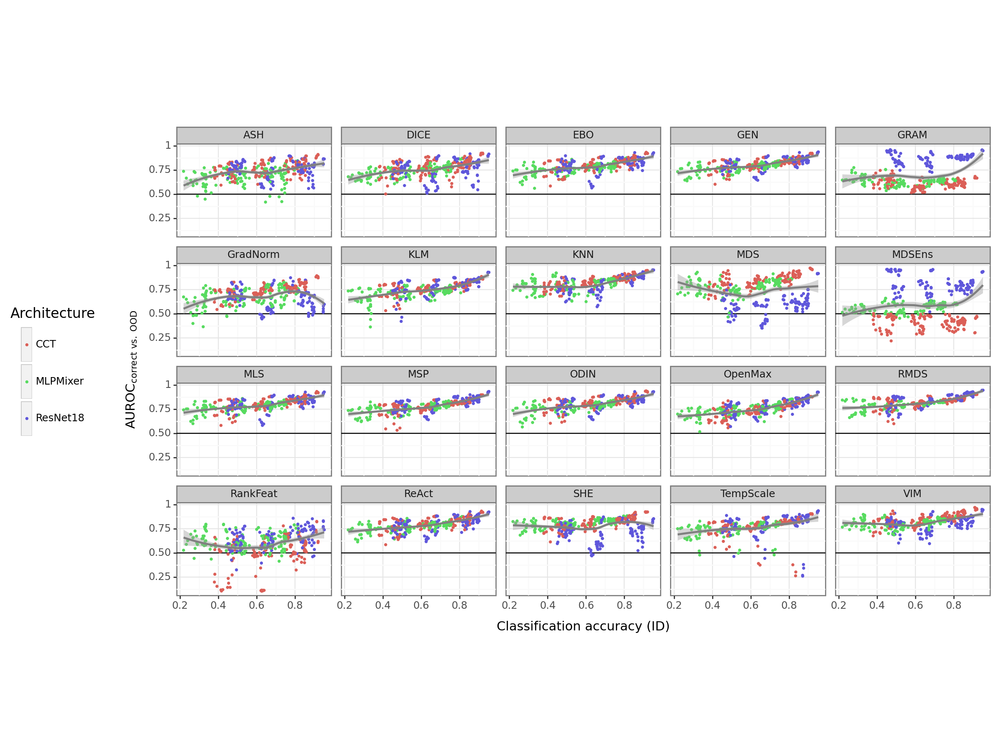

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-correctauroc-arch_nice-all.pdf


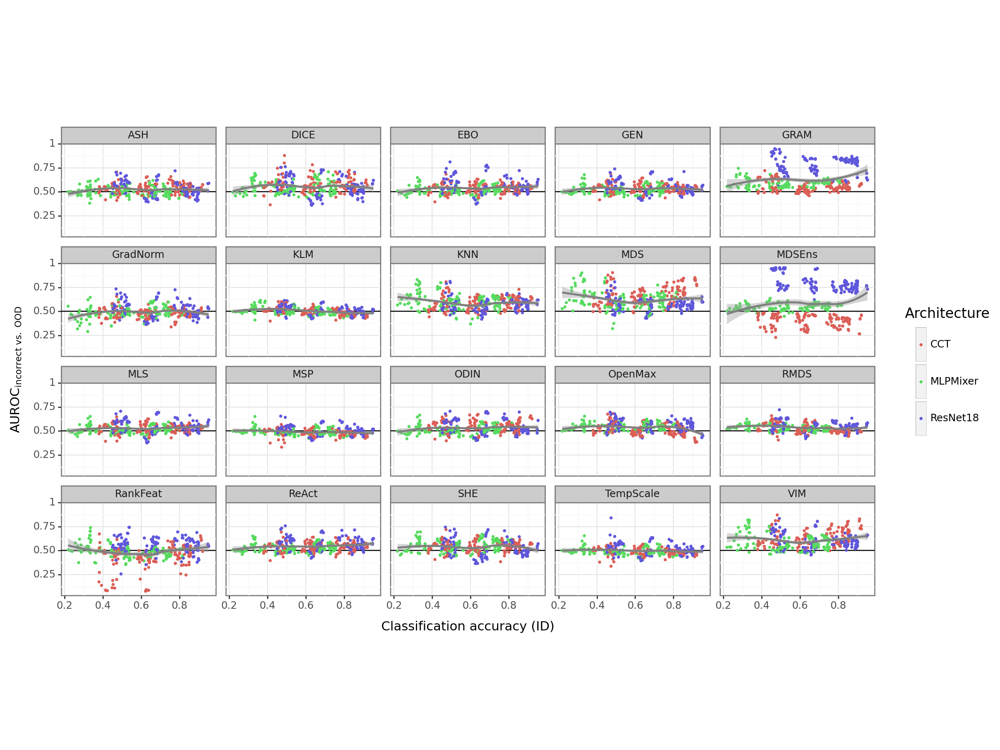

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-incorrectauroc-arch_nice-all.pdf


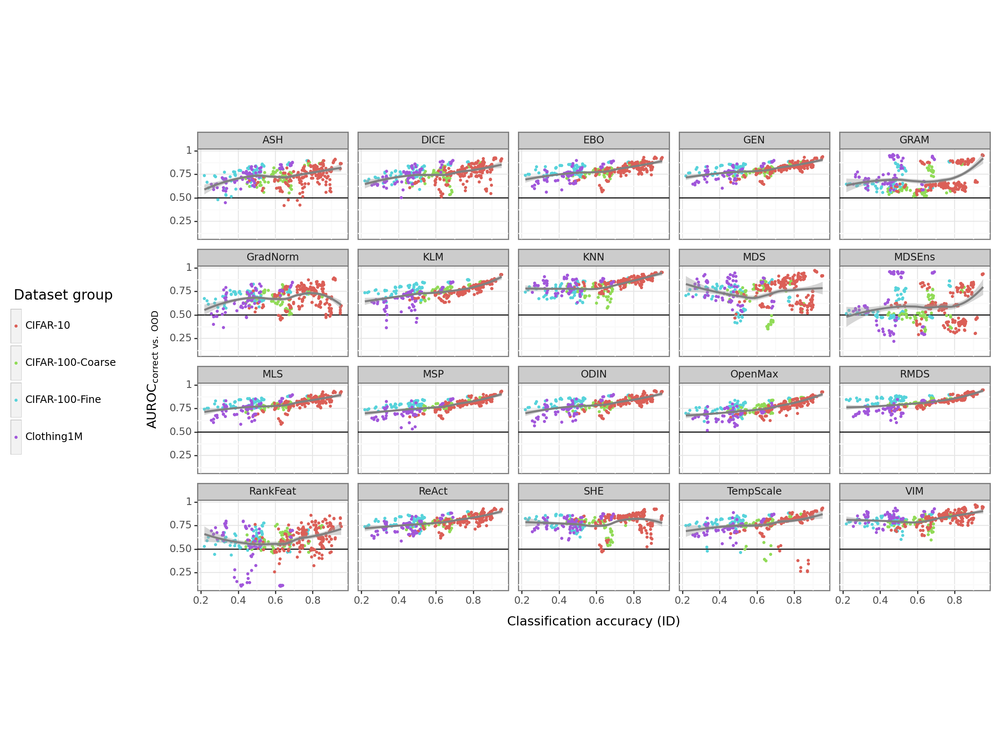

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-correctauroc-iid_dataset_nice-all.pdf


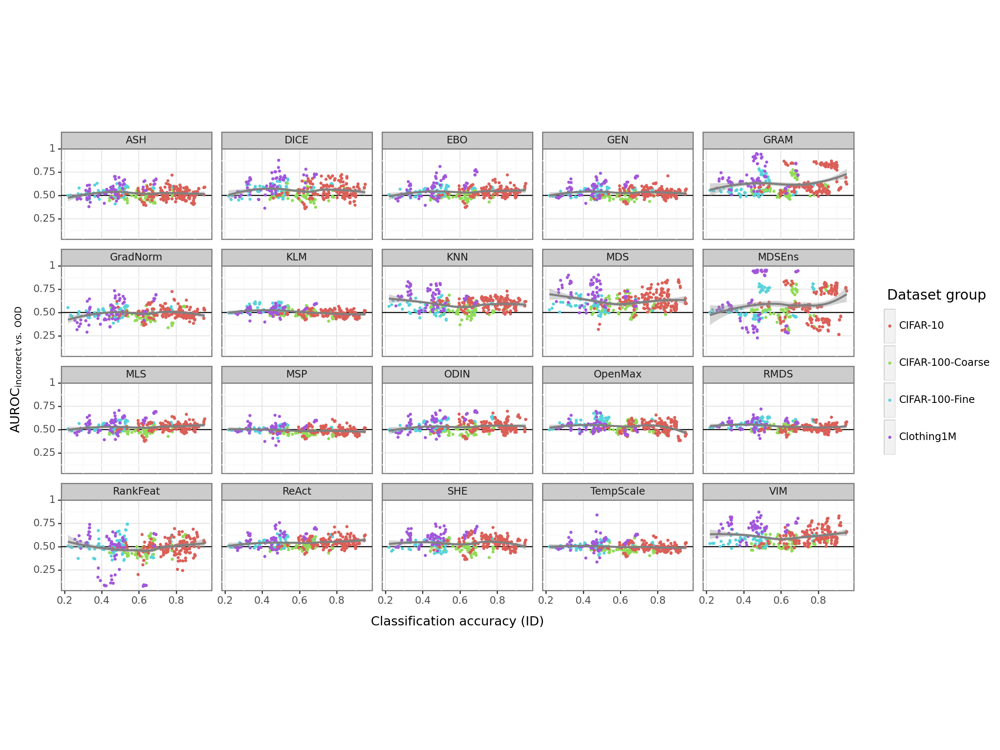

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-incorrectauroc-iid_dataset_nice-all.pdf


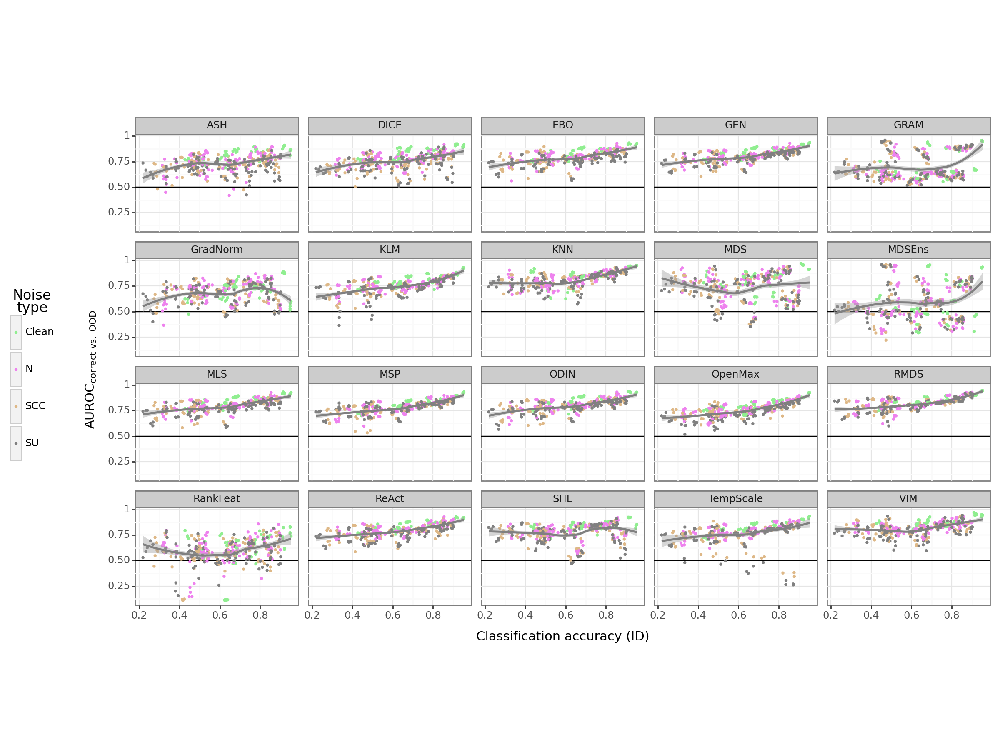

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-correctauroc-noise_type_nice-all.pdf


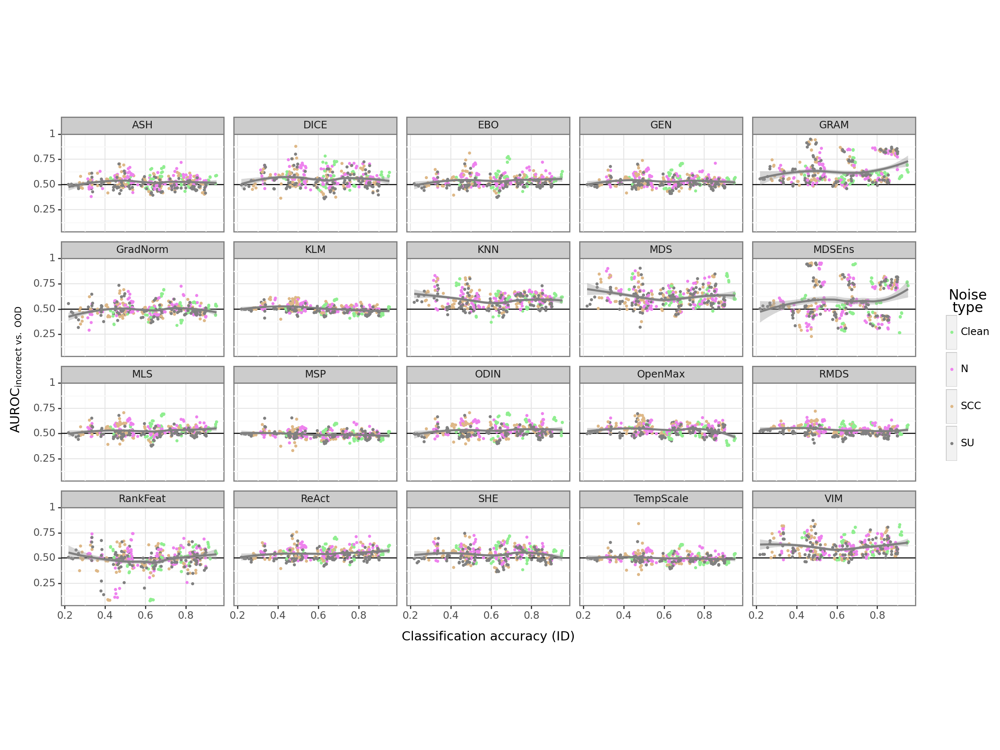

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/accuracy-vs-incorrectauroc-noise_type_nice-all.pdf


In [27]:
df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]


aggregate_ood_dataset_func = lambda df: df.median()
df_median_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()
df_median_ood["noise_type"] = pd.Categorical(df_median_ood["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)
df_median_ood['noise_type_nice'] = df_median_ood['noise_type'].apply(lambda x: nice_noise_names[x])

for color in ["noise_rate","arch_nice","iid_dataset_nice","noise_type_nice"]:
    if color == "noise_rate":
        color_scale_left = scale_color_continuous(name="Noise rate")
        color_scale_right = color_scale_left
        legend_theme = theme(
                legend_key_width=10,
                legend_key_height=30,
                legend_position='left',
                legend_title_align='center',
                legend_title = element_text(size=12),
                legend_text_colorbar = element_text(size=8, va="bottom"),
            )
    elif color == "arch_nice":
        color_scale_left = scale_color_discrete(name="Architecture")
        color_scale_right = color_scale_left
        legend_theme = theme(
                legend_key_width=10,
                legend_key_height=30,
                legend_position='top',
                legend_title_align='center',
                legend_title = element_text(size=12)
            )
    elif color == "iid_dataset_nice":
        color_scale_left = scale_color_discrete(name="Dataset group")
        color_scale_right = color_scale_left
        legend_theme = theme(
                legend_key_width=10,
                legend_key_height=30,
                legend_position='top',
                legend_title_align='center',
                legend_title = element_text(size=12)
            )
    elif color == "noise_type_nice":
        color_scale_left = scale_color_manual(name="Noise\ntype", values = {"Clean": "lightgreen", "N": "violet", "SCC": "burlywood", "SU": "gray"})
        color_scale_right = color_scale_left
        legend_theme = theme(
                legend_key_width=10,
                legend_key_height=30,
                legend_position='top',
                legend_title_align='center',
                legend_title = element_text(size=12)
            )
        
    plt = (ggplot(df_median_ood, aes("accuracy", "correct_ood_auroc", color=color))
     + geom_hline(yintercept=0.5)
     + geom_point(size=0.5)
     + stat_smooth(method="loess", color="grey")
     + facet_wrap("~method_fmt", ncol=5)
     + scale_y_continuous(name="$\mathrm{AUROC_{correct~vs.~OOD}}$")
     + color_scale_left
     + common_x_axis
     + scale_alpha_continuous(guide=False)
     + theme_bw()
     + common_theme
     + theme(aspect_ratio=0.6)
     + legend_theme
     + theme(legend_position='left')
    )
    print(plt)
    plt.save(f"supp_plots/accuracy-vs-correctauroc-{color}-all.pdf")
    
    plt = (ggplot(df_median_ood, aes("accuracy", "incorrect_ood_auroc", color=color))
     + geom_hline(yintercept=0.5)
     + geom_point(size=0.5)
     + stat_smooth(method="loess", color="grey")
     + facet_wrap("~method_fmt", ncol=5)
     + scale_y_continuous(name="$\mathrm{AUROC_{incorrect~vs.~OOD}}$")
     + color_scale_right
     + common_x_axis
     + scale_alpha_continuous(guide=False)
     + theme_bw()
     + common_theme
     + theme(aspect_ratio=0.6)
     + legend_theme
     + theme(legend_position='right')
    )
    
    print(plt)
    plt.save(f"supp_plots/accuracy-vs-incorrectauroc-{color}-all.pdf")

## Figure 9 (Supplementary)

In [28]:
df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]

aggregate_ood_dataset_func = lambda df: df.median()
df_median_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()

res = []

def aso_pairwise_methods(scores_per_method):
    eps_min = multi_aso(scores_per_method, confidence_level=0.95, return_df=True, seed=0, num_jobs=-1, use_bonferroni=False, show_progress=False)
    print(eps_min)
    print(eps_min.to_markdown())

    return eps_min

for method in df_20_ood["method_fmt"].unique():
#for method in ["msp"]:
    print(method)
    df_method = df_median_ood[df_median_ood["method_fmt"] == method]
    scores_per_metric = {
        "failure_auroc": df_method["failure_auroc"],
        "auroc": df_method["auroc"]
    }
    eps_min = aso_pairwise_methods(scores_per_metric)

    res.append({
        "method": method,
        "failure_vs_ood": eps_min["auroc"]["failure_auroc"],
        "ood_vs_failure": eps_min["failure_auroc"]["auroc"]
    })
    print("...........................")

KNN
               failure_auroc     auroc
failure_auroc            1.0  0.194325
auroc                    1.0  1.000000
|               |   failure_auroc |    auroc |
|:--------------|----------------:|---------:|
| failure_auroc |               1 | 0.194325 |
| auroc         |               1 | 1        |
...........................
KLM
               failure_auroc     auroc
failure_auroc            1.0  0.002768
auroc                    1.0  1.000000
|               |   failure_auroc |      auroc |
|:--------------|----------------:|-----------:|
| failure_auroc |               1 | 0.00276845 |
| auroc         |               1 | 1          |
...........................
ASH
               failure_auroc     auroc
failure_auroc            1.0  0.000601
auroc                    1.0  1.000000
|               |   failure_auroc |       auroc |
|:--------------|----------------:|------------:|
| failure_auroc |               1 | 0.000601195 |
| auroc         |               1 | 1          

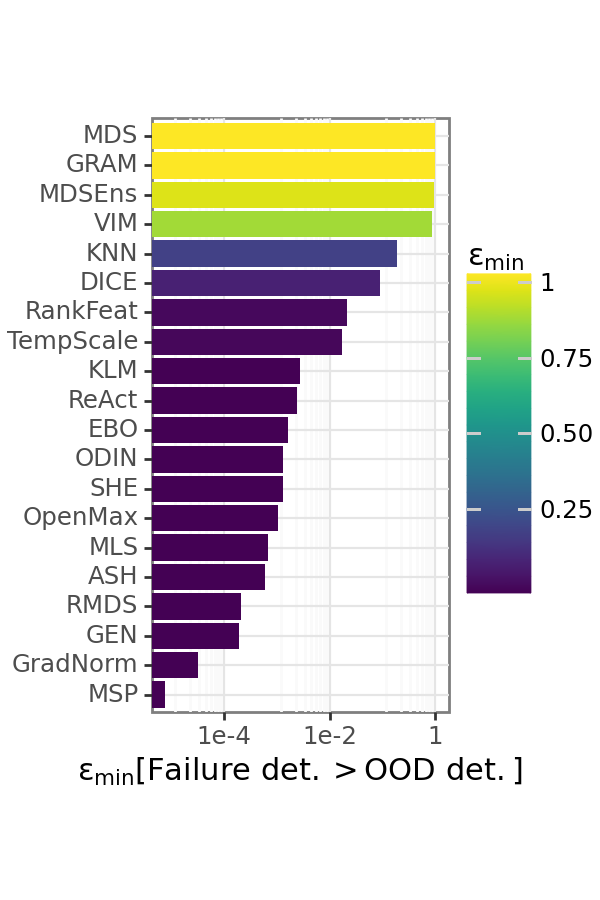

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 3 x 4.5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/emin-failure-vs-ood-per-method.pdf


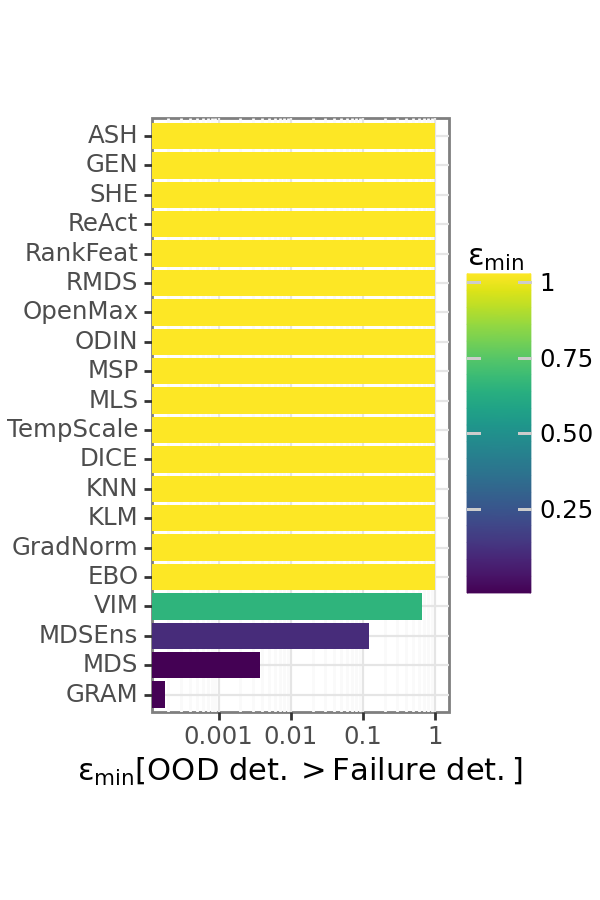

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 3 x 4.5 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/emin-ood-vs-failure-per-method.pdf


In [29]:
df_res = pd.DataFrame(res)
#print(res)
df
plt = (ggplot(df_res,aes("reorder(method,failure_vs_ood)","failure_vs_ood",fill="failure_vs_ood"))
              + geom_col()
              
              
              + scale_fill_continuous(name="$\epsilon_{\min}$")
              + coord_flip()
              + scale_y_log10(name="$\epsilon_{\min}[Failure~det.>OOD~det.]$")
              + theme_bw()
              + theme(axis_title_y=element_blank(), aspect_ratio=2, figure_size=(3,4.5))
            )
print(plt)
plt.save(f"supp_plots/emin-failure-vs-ood-per-method.pdf")

plt = (ggplot(df_res,aes("reorder(method,ood_vs_failure)","ood_vs_failure",fill="ood_vs_failure"))
        + geom_col()
        + scale_y_log10(name="$\epsilon_{\min}[OOD~det.>Failure~det.]$")
        + scale_fill_continuous(name="$\epsilon_{\min}$")
        + coord_flip()
        + theme_bw()
        + theme(axis_title_y=element_blank(), aspect_ratio=2, figure_size=(3,4.5))
        )
print(plt)
plt.save(f"supp_plots/emin-ood-vs-failure-per-method.pdf")

## Figure 10 (Supplementary)

   index method method_nice method_fmt training_dataset training_dataset_nice  \
0      0  ash_s       ASH-s        ASH          cifar10              CIFAR-10   
1      1  ash_s       ASH-s        ASH          cifar10              CIFAR-10   
2      2  ash_s       ASH-s        ASH          cifar10              CIFAR-10   
3      3  ash_s       ASH-s        ASH          cifar10              CIFAR-10   
4      4  ash_s       ASH-s        ASH          cifar10              CIFAR-10   

  ds_group noisy_or_not iid_dataset iid_dataset_nice checkpoint      arch  \
0  cifar10        clean     cifar10         CIFAR-10  best.ckpt       cct   
1  cifar10        clean     cifar10         CIFAR-10  best.ckpt       cct   
2  cifar10        clean     cifar10         CIFAR-10  best.ckpt       cct   
3  cifar10        clean     cifar10         CIFAR-10  best.ckpt  mlpmixer   
4  cifar10        clean     cifar10         CIFAR-10  best.ckpt  mlpmixer   

  arch_nice seed noise_type  noise_rate  num_class

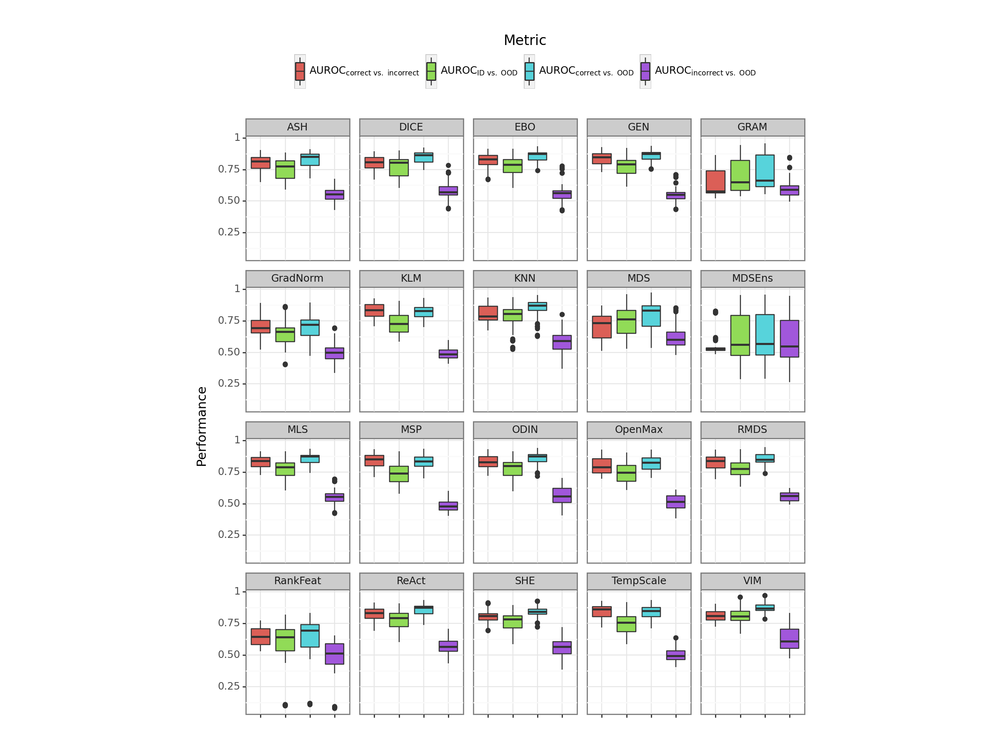

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/comparing-metrics-per-method-cleansetting.pdf


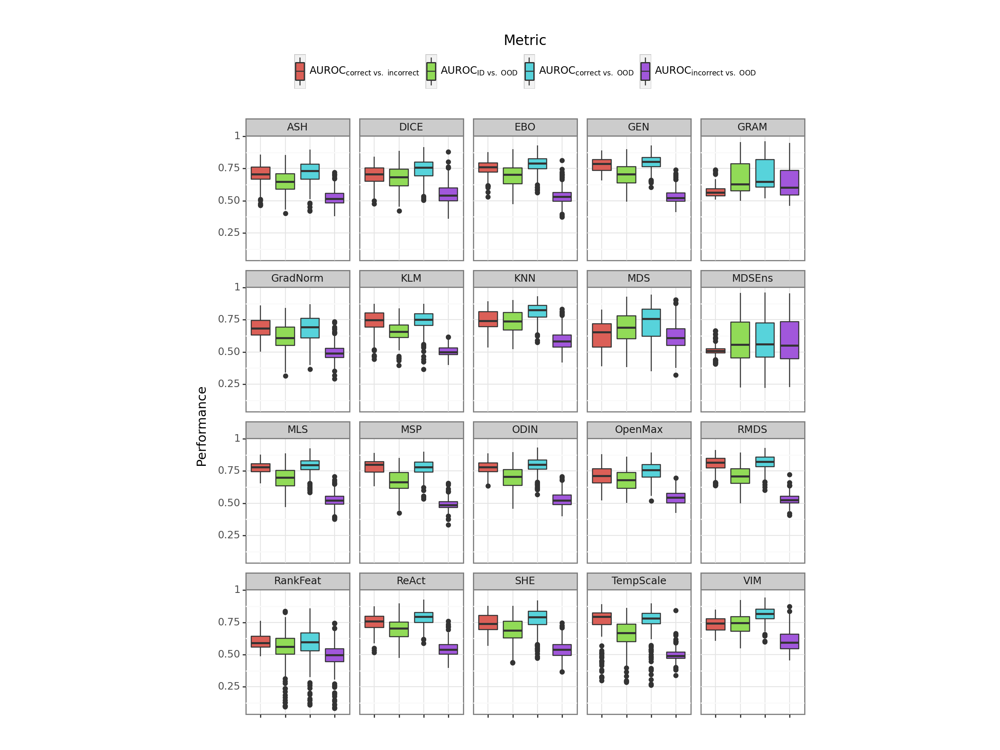

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 9 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/comparing-metrics-per-method-noisysetting.pdf


In [30]:
df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]

aggregate_ood_dataset_func = lambda df: df.median()
df_median_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()
df_median_ood["noise_type"] = pd.Categorical(df_median_ood["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)
df_median_ood['noise_type_nice'] = df_median_ood['noise_type'].apply(lambda x: nice_noise_names[x])

df_median_ood_melted = pd.melt(df_median_ood, value_vars=['failure_auroc', 'auroc', "correct_ood_auroc","incorrect_ood_auroc"], id_vars=params+["noise_type_nice"]).reset_index()
print(df_median_ood_melted.head())
df_median_ood_melted["metric"] = pd.Categorical(df_median_ood_melted["variable"], categories = ["failure_auroc",'auroc', "correct_ood_auroc","incorrect_ood_auroc"], ordered=True)

plt = (ggplot(df_median_ood_melted[df_median_ood_melted["noise_rate"] == 0], aes("metric", "value", fill="metric"))
     + geom_boxplot(size=0.5)
     + facet_wrap("method_fmt")
     + scale_fill_discrete(name="Metric", labels=["$\mathrm{AUROC_{correct~vs.~incorrect}}$","$\mathrm{AUROC_{ID~vs.~OOD}}$","$\mathrm{AUROC_{correct~vs.~OOD}}$","$\mathrm{AUROC_{incorrect~vs.~OOD}}$"])
     + scale_x_discrete(name="")
     + scale_y_continuous(name="Performance")
     + theme_bw()
     + common_theme
     + theme(aspect_ratio=1.2)
     + legend_theme
     + theme(legend_position='top', axis_text_x=element_blank())
    )
print(plt)
plt.save(f"supp_plots/comparing-metrics-per-method-cleansetting.pdf")

plt = (ggplot(df_median_ood_melted[df_median_ood_melted["noise_rate"] > 0], aes("metric", "value", fill="metric"))
     + geom_boxplot(size=0.5)
     + facet_wrap("method_fmt")
     + scale_fill_discrete(name="Metric", labels=["$\mathrm{AUROC_{correct~vs.~incorrect}}$","$\mathrm{AUROC_{ID~vs.~OOD}}$","$\mathrm{AUROC_{correct~vs.~OOD}}$","$\mathrm{AUROC_{incorrect~vs.~OOD}}$"])
     + scale_x_discrete(name="")
     + scale_y_continuous(name="Performance")
     + theme_bw()
     + common_theme
     + theme(aspect_ratio=1.2)
     + legend_theme
     + theme(legend_position='top', axis_text_x=element_blank())
    )
print(plt)
plt.save(f"supp_plots/comparing-metrics-per-method-noisysetting.pdf")

## Figure 11 (Supplementary)

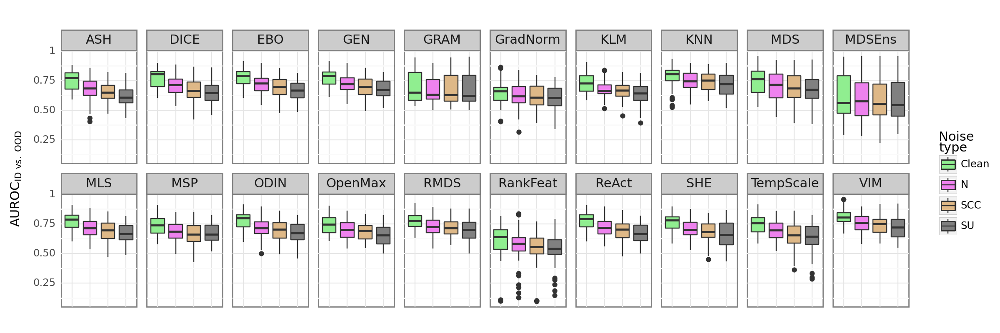

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 12 x 4 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/noise_type-vs-auroc-boxplots.pdf


In [31]:
df_20_ood = df_ood[df_ood["method"].isin(the_20_methods)]

aggregate_ood_dataset_func = lambda df: df.median()
df_median_ood = aggregate_ood_dataset_func(df_20_ood.groupby(params)[ood_metrics]).reset_index()

df_median_ood["noise_type"] = pd.Categorical(df_median_ood["noise_type"], categories = ["clean","real","asymm","symm"], ordered=True)
df_median_ood['noise_type_nice'] = df_median_ood['noise_type'].apply(lambda x: nice_noise_names[x])

#limits = ["clean","real","asymm","symm"][::-1]
plt = (
    ggplot(df_median_ood)
    + geom_boxplot(aes(x='factor(noise_type_nice)', y='auroc', fill='noise_type_nice'))
    + facet_wrap("~method_fmt",ncol=10)
    #+ coord_flip()
    + scale_y_continuous(
        name='$AUROC_{ID~vs.~OOD}$'
    )
    + scale_fill_manual(name="Noise\ntype", values = {"Clean": "lightgreen", "N": "violet", "SCC": "burlywood", "SU": "gray"})
    #+ scale_fill_discrete(guide=False)
    + theme_bw()
    + theme(figure_size=(12, 4), axis_text_x=element_blank(), axis_title_x=element_blank(), axis_ticks=element_blank(), strip_text=element_text(size=11))  # here you define the plot size
)
print(plt)
plt.save("supp_plots/noise_type-vs-auroc-boxplots.pdf")

## Figure 13 (Supplementary)

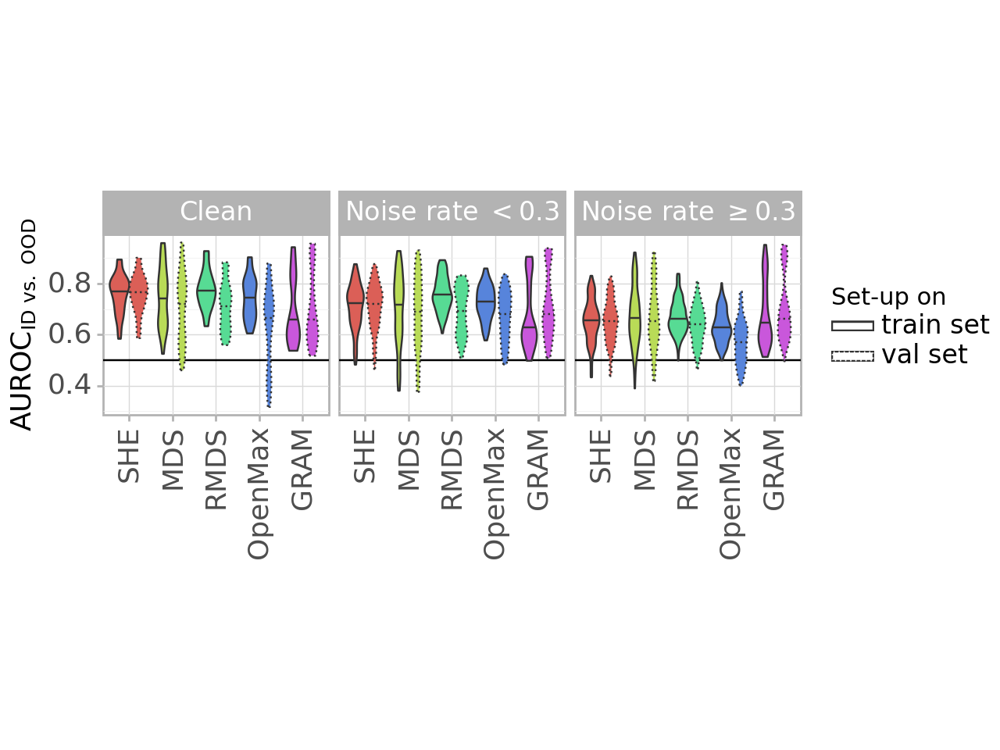

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6.4 x 4.8 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: supp_plots/val-or-not-clean_vs_noisy_violins.pdf


In [32]:
method_pairs = [
    ["openmax-train", "openmax-val"],
    ["mds-train", "mds-val"],
    ["rmds-train", "rmds-val"],
    ["she-train", "she-val"],
    ["gram_mod-train", "gram_mod-val"],
]
methods_to_plot = list()

for method_pair in method_pairs:
    scores_per_method = dict()
    for method in method_pair:
        methods_to_plot.append(method)
        df_m = df_avg_ood[df_avg_ood["method"] == method]
        scores_per_method[method] = df_m["auroc"]

method_dict = {"gram_mod": "GRAM",
               "mds": "MDS",
               "rmds": "RMDS",
               "she": "SHE",
               "openmax": "OpenMax"}

df_val_methods = df_avg_ood[df_avg_ood["method"].isin(methods_to_plot)]
df_val_methods["setup_set"] = df_val_methods["method"].apply(lambda x: "train set" if "train" in x else "val set")
df_val_methods["method_root"] = df_val_methods["method"].apply(lambda x: method_dict[x.split("-")[0]])
df_val_methods["noise_setting"] = df_val_methods["noise_rate"].apply(lambda x: "Clean" if x == 0 else "Noise rate $< 0.3$" if x < 0.3 else "Noise rate $\geq 0.3$")
df_val_methods["method_root"] = pd.Categorical(df_val_methods["method_root"], categories = ["SHE","MDS","RMDS","OpenMax","GRAM"], ordered=True)

plt = (ggplot(df_val_methods, aes("method_root", "auroc", fill="method_root", linetype="setup_set"))
 + geom_hline(yintercept=0.5)
 + facet_wrap("noise_setting")
 + geom_violin(draw_quantiles=0.5)
 + scale_x_discrete(name="")
 + scale_fill_discrete(guide=False)
 + scale_linetype_manual(name="Set-up on", values=["solid","dotted"])
 + scale_y_continuous(name="$\mathrm{AUROC_{ID~vs.~OOD}}$")
 + theme_light()
 + theme(axis_text_x=element_text(rotation=90, hjust=0.5), aspect_ratio=0.8)
 + theme_text_sizes
 + theme(strip_text=element_text(size=12), legend_key_width=20, legend_key_height=5)
)
print(plt)
plt.save(f"supp_plots/val-or-not-clean_vs_noisy_violins.pdf")

# Poster <a id="poster"></a>

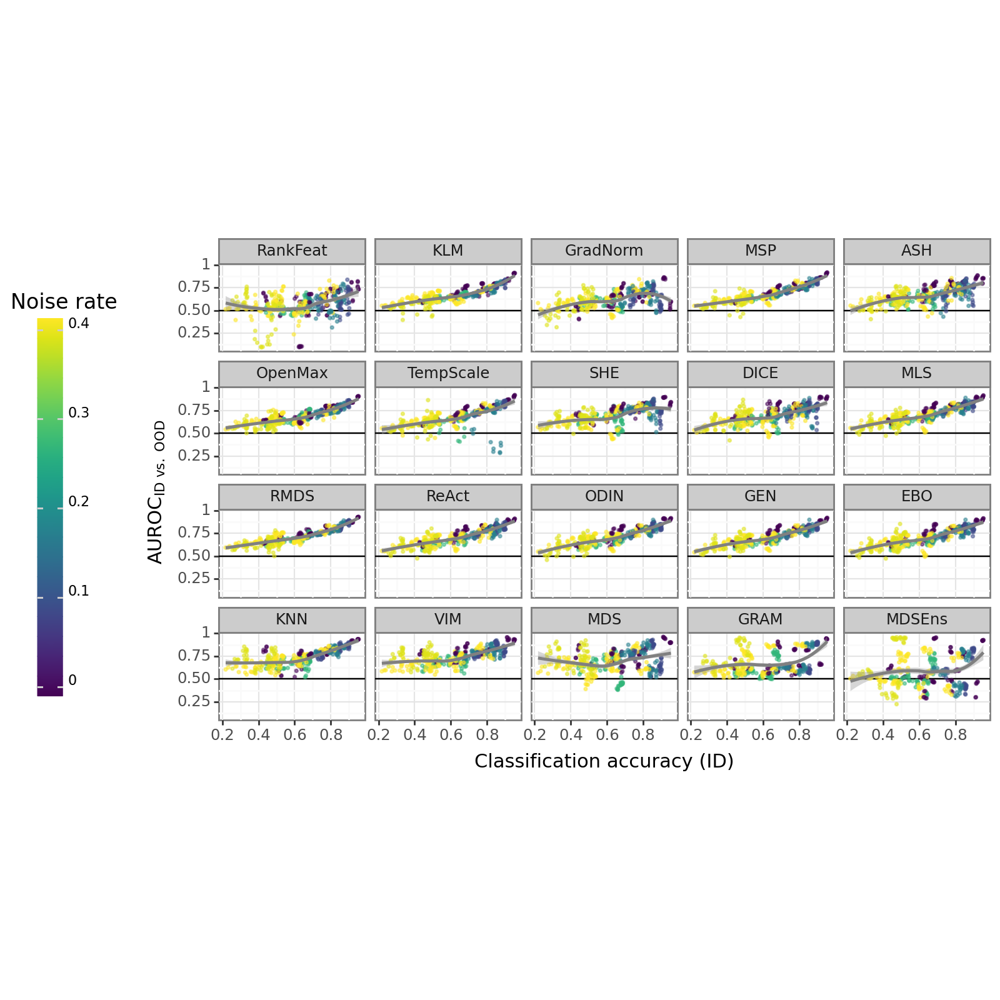

/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 8 in image.
/media/gala/53721fd6-906b-4cd6-905a-9296baca76d7/home/test/gala/.conda/envs/openood/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: poster_plots/auroc-vs-accuracy-noise_rate.pdf


In [33]:
color = "noise_rate"
color_scale_left = scale_color_continuous(name="Noise rate")
color_scale_right = color_scale_left
legend_theme = theme(
    legend_key_width=10,
    legend_key_height=30,
    legend_position='left',
    legend_title_align='center',
    legend_title = element_text(size=12),
    legend_text_colorbar = element_text(size=8, va="bottom"),
)
common_x_axis = scale_x_continuous(
        name='Classification accuracy (ID)'
    )

gap_median = df_noisy_avg_ood.groupby("method_fmt")["auroc"].max().sort_values().index

df_avg_ood_20["method_nice_sorted"] = pd.Categorical(df_avg_ood_20["method_fmt"], categories=gap_median, ordered=True)

plt = (ggplot(df_avg_ood_20, aes("accuracy", "auroc", color=color))
     #+ common_hline
     + geom_hline(yintercept=0.5)
     + geom_point(size=0.5,alpha=0.5)
     + stat_smooth(method="loess", color="grey")
     + facet_wrap("~method_nice_sorted", ncol=5)
     + scale_y_continuous(name="$\mathrm{AUROC_{ID~vs.~OOD}}$")
     + color_scale_left
     + common_x_axis
     + scale_alpha_continuous(guide=False)
     + theme_bw()
     + common_theme
     + theme(aspect_ratio=0.6)
     + legend_theme
     + theme(legend_position='left',figure_size=(8,8))
     #+ labs(color = 'Noise rate')
    )
print(plt)
plt.save(f"poster_plots/auroc-vs-accuracy-noise_rate.pdf")

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_noisy_worse-seeds0-last*.ckpt.png


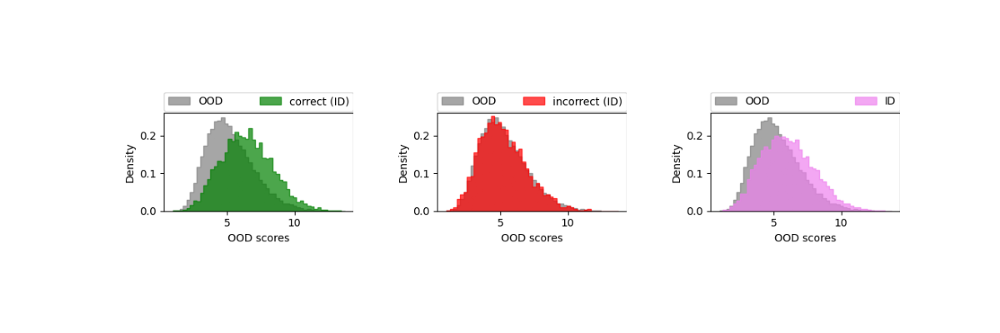

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10-seeds0-last*.ckpt.png


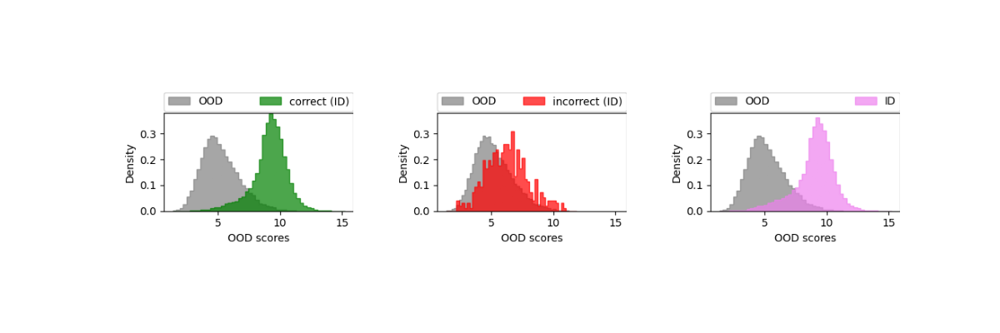

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_noisy_agg-seeds0-last*.ckpt.png


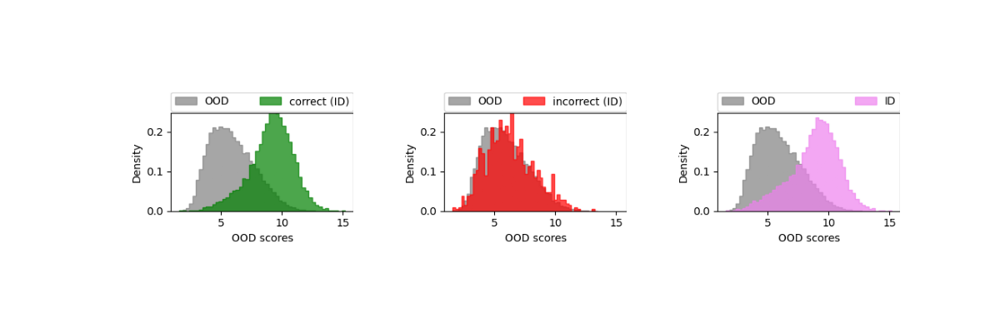

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_asymm_worse-seeds0-last*.ckpt.png


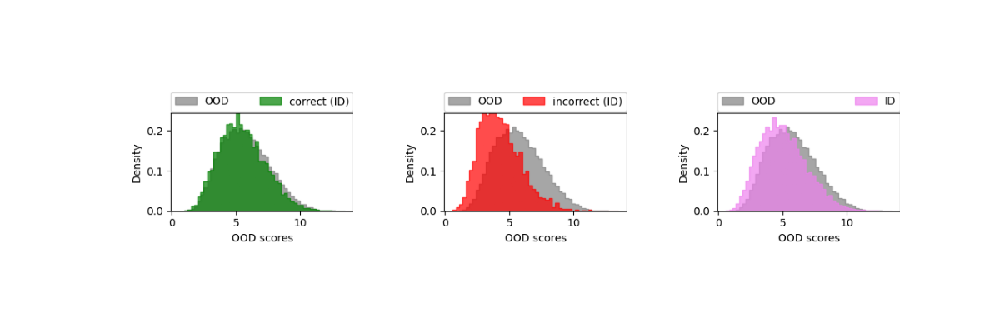

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_symm_random1-seeds0-last*.ckpt.png


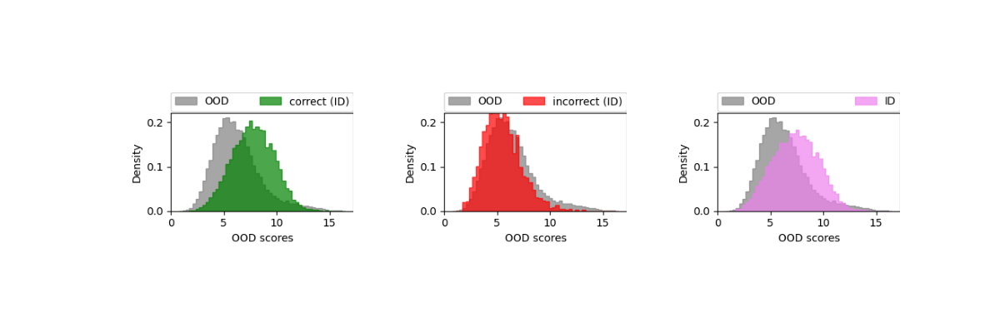

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_asymm_agg-seeds0-last*.ckpt.png


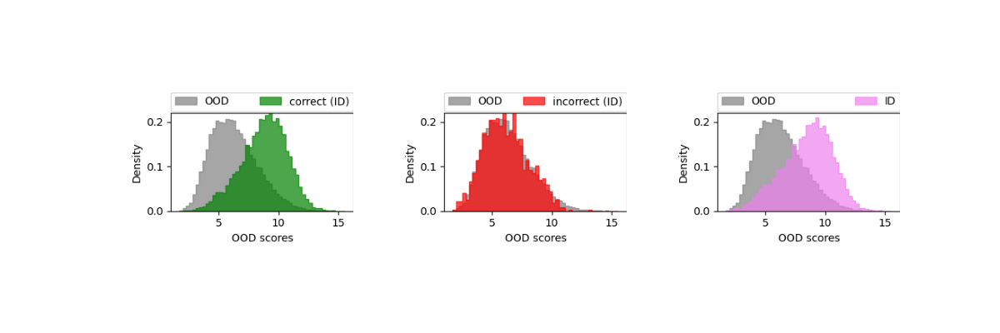

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_symm_agg-seeds0-last*.ckpt.png


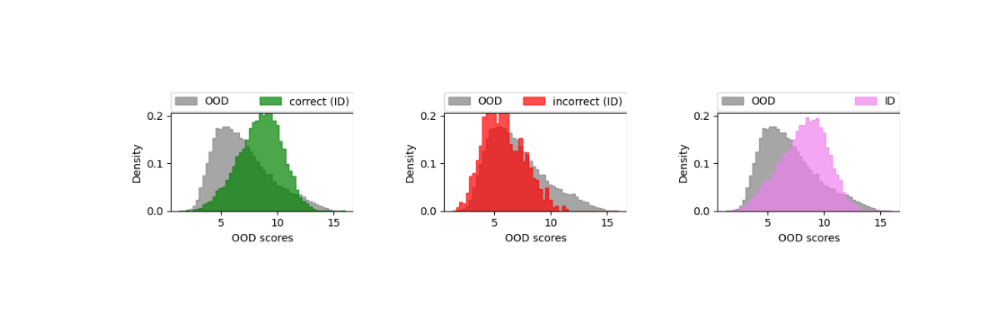

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_noisy_random1-seeds0-last*.ckpt.png


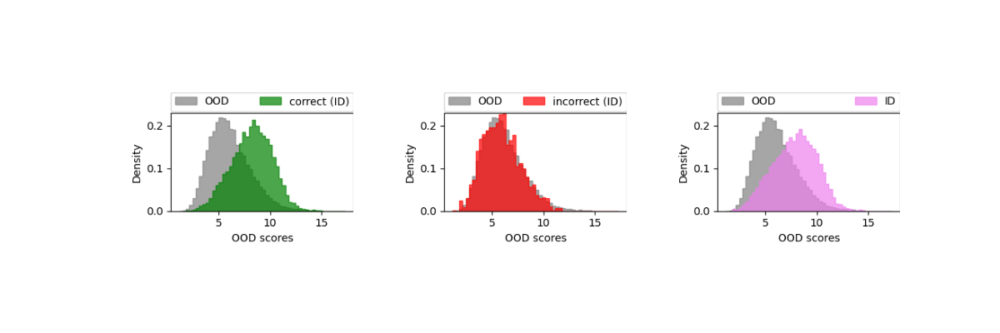

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_asymm_random1-seeds0-last*.ckpt.png


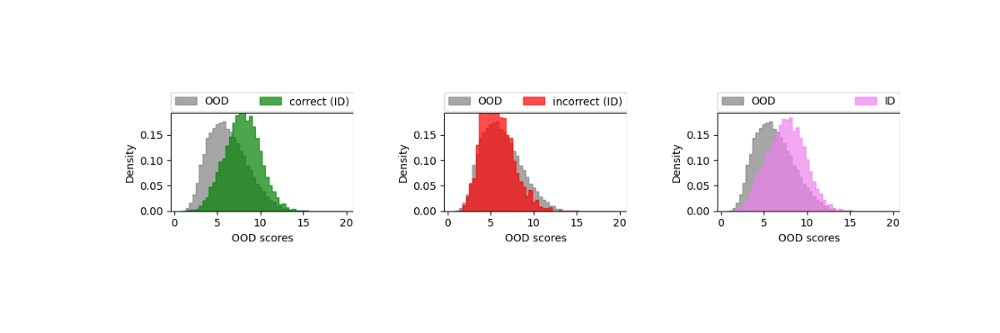

./ood_plots/mls/correct_ood_histo-mls-resnet-OODsvhn-cifar10_symm_worse-seeds0-last*.ckpt.png


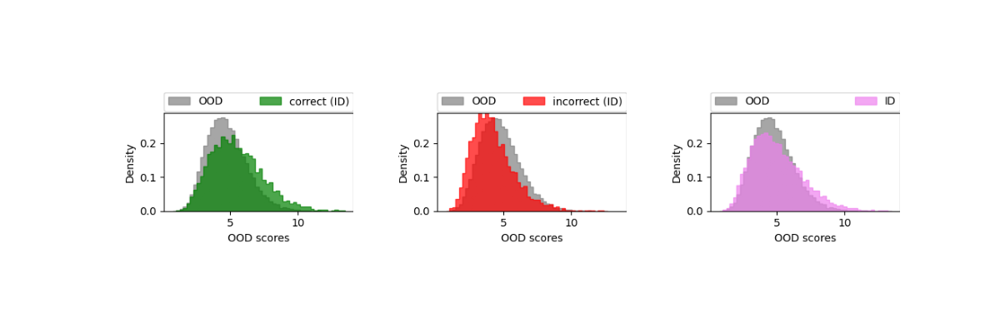

In [34]:
from matplotlib import pyplot as plt
import matplotlib

method = "mls"
arch = "resnet"
seed = "s0"
checkpoint = "last*.ckpt"
ood_ds = "svhn"
id_ds = "cifar10"

path_template = f"./ood_plots/{method}/correct*-{method}-{arch}-OOD{ood_ds}-{id_ds}*-seed{seed}-{checkpoint}.png"

import glob
import matplotlib.image as mpimg

paths = glob.glob(path_template)

for path in paths:
    print(path)
    path2 = path.replace("correct","incorrect")
    path3 = path.replace("correct","id")
    imgs = [mpimg.imread(path),  mpimg.imread(path2), mpimg.imread(path3)]

    n_col = len(imgs)
    n_row = 1

    _, axs = plt.subplots(n_row, n_col, figsize=(6, 2))
    axs = axs.flatten()
    
    for img, ax in zip(imgs, axs):
        ax.axis('off')
        ax.imshow(img)
    
    plt.show()